In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [2]:
#installing libraries
!pip install fastai
!pip install gdown
!pip install annoy
!pip install efficientnet_pytorch
!pip install git+https://github.com/qubvel/efficientnet


  Cloning https://github.com/qubvel/efficientnet to /tmp/pip-req-build-sl0a9s55
  Running command git clone -q https://github.com/qubvel/efficientnet /tmp/pip-req-build-sl0a9s55


In [3]:
#importing necessary libraries
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import gdown
from fastai.vision import *
from fastai.metrics import accuracy, top_k_accuracy
import torch
from efficientnet_pytorch import EfficientNet
from annoy import AnnoyIndex
import zipfile
import time
from google.colab import drive
%matplotlib inline

In [4]:
#training using CUDA instead of GPU because it is faster 
train_on_gpu = torch.cuda.is_available()
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)

if not train_on_gpu:
    print('CUDA is not available.  Training on CPU ... To use GPU, go under edit > notebook settings')
else:
    print('CUDA is available!  Training on GPU ...')
    print(gpu_info)

CUDA is available!  Training on GPU ...
Wed Apr 20 12:12:51 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   39C    P0    27W / 250W |      2MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                

# **Loading/Pre-processing Data from DeepFashion Database**

In [10]:
#getting the metadata from the drive connected to the DeepFashion database
url = 'https://drive.google.com/uc?id=1d1nWNVHdIAvzuGyaSrajuPIffQTjbnsp'
output = 'list_category_cloth.txt'
gdown.download(url, output, quiet=False)

url = 'https://drive.google.com/uc?id=1quO7Fck8MsKum4lzeyMSbbSbL6yGAIDJ'
output = 'list_category_img.txt'
gdown.download(url, output, quiet=False)

url = 'https://drive.google.com/uc?id=1_rg5_UZ-ZXkcg0yM_-PlN9yLtYT13sSx'
output = 'list_eval_partition.txt'
gdown.download(url, output, quiet=False)

Downloading...
From: https://drive.google.com/uc?id=1d1nWNVHdIAvzuGyaSrajuPIffQTjbnsp
To: /content/list_category_cloth.txt
100%|██████████| 882/882 [00:00<00:00, 1.75MB/s]
Downloading...
From: https://drive.google.com/uc?id=1quO7Fck8MsKum4lzeyMSbbSbL6yGAIDJ
To: /content/list_category_img.txt
100%|██████████| 21.4M/21.4M [00:00<00:00, 95.4MB/s]
Downloading...
From: https://drive.google.com/uc?id=1_rg5_UZ-ZXkcg0yM_-PlN9yLtYT13sSx
To: /content/list_eval_partition.txt
100%|██████████| 22.2M/22.2M [00:00<00:00, 51.2MB/s]


'list_eval_partition.txt'

In [11]:
#extracting the images from the zip file downloaded fromm the DeepFashion Database 
root_path = "/content/"
zip_ref = zipfile.ZipFile("/content/gdrive/Shared drives/DATS6501 Capstone Group 1/Fashion Data/img.zip", 'r')
zip_ref.extractall(root_path)
zip_ref.close()

In [12]:
#setting the info from the metadata text files (image paths, clothing catagories, data type (train,val,test)) to lists 

category_list = []
image_path_list = []
data_type_list = []
# category names
with open('list_category_cloth.txt', 'r') as f:
    for i, line in enumerate(f.readlines()):
        if i > 1:
            category_list.append(line.split(' ')[0])

# category map
with open('list_category_img.txt', 'r') as f:
    for i, line in enumerate(f.readlines()):
        if i > 1:
            image_path_list.append([word.strip() for word in line.split(' ') if len(word) > 0])


# train, valid, test
with open('list_eval_partition.txt', 'r') as f:
    for i, line in enumerate(f.readlines()):
        if i > 1:
            data_type_list.append([word.strip() for word in line.split(' ') if len(word) > 0])

In [13]:
#creating dataframe with the image path, clothing category, and data type of each image in the dataset
data_df = pd.DataFrame(image_path_list, columns=['image_path', 'category_number'])
data_df['category_number'] = data_df['category_number'].astype(int)
data_df = data_df.merge(pd.DataFrame(data_type_list, columns=['image_path', 'dataset_type']), on='image_path')
data_df['category'] = data_df['category_number'].apply(lambda x: category_list[int(x) - 1])
data_df = data_df.drop('category_number', axis=1)
data_df.head()

,image_path,dataset_type,category
0,img/Sheer_Pleated-Front_Blouse/img_00000001.jpg,train,Blouse
1,img/Sheer_Pleated-Front_Blouse/img_00000002.jpg,train,Blouse
2,img/Sheer_Pleated-Front_Blouse/img_00000003.jpg,val,Blouse
3,img/Sheer_Pleated-Front_Blouse/img_00000004.jpg,train,Blouse
4,img/Sheer_Pleated-Front_Blouse/img_00000005.jpg,test,Blouse


/usr/local/lib/python3.7/dist-packages/fastai/vision/transform.py:247: UserWarning: torch.solve is deprecated in favor of torch.linalg.solveand will be removed in a future PyTorch release.
torch.linalg.solve has its arguments reversed and does not return the LU factorization.
To get the LU factorization see torch.lu, which can be used with torch.lu_solve or torch.lu_unpack.
X = torch.solve(B, A).solution
should be replaced with
X = torch.linalg.solve(A, B) (Triggered internally at  ../aten/src/ATen/native/BatchLinearAlgebra.cpp:766.)
  return _solve_func(B,A)[0][:,0]


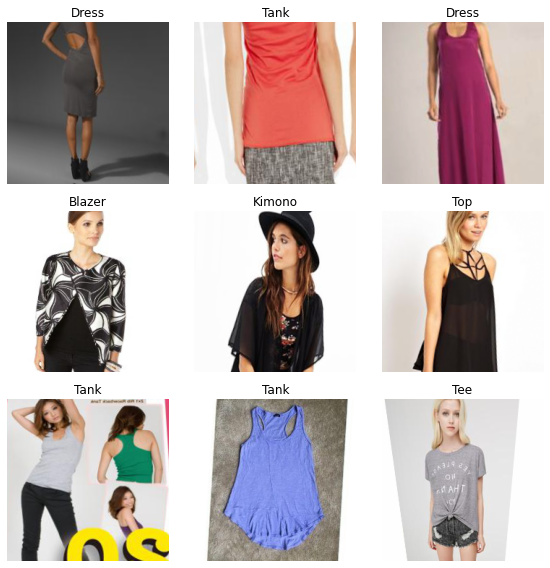

In [14]:
#getting the train and test images 
train_images = ImageList.from_df(df=data_df, path=root_path, cols='image_path').split_by_idxs(
    (data_df[data_df['dataset_type']=='train'].index),
    (data_df[data_df['dataset_type']=='val'].index)).label_from_df(cols='category')
test_images = ImageList.from_df(df=data_df[data_df['dataset_type'] == 'test'], path=root_path, cols='image_path')

#normalizing the data and setting batch size 
data = train_images.transform(get_transforms(), size=224).databunch(bs=32).normalize(imagenet_stats)
#for EfficientNet5 - batch size of 32 is too big 
#data = train_images.transform(get_transforms(), size=224).databunch(bs=16).normalize(imagenet_stats)
data.add_test(test_images)
data.show_batch(rows=3, figsize=(8,8))

# **Running EfficientNetB3**

In [15]:
#loading efficientnetb3 from pytorch 
ef_model = EfficientNet.from_pretrained('efficientnet-b3')
#ef_model = EfficientNet.from_pretrained('efficientnet-b5')
ef_head = create_head(1536, data.c, concat_pool=False)
#ef_head = create_head(2048, data.c, concat_pool=False)
ef_head = nn.Sequential(*(list(ef_head.children())[3:]))
ef_model._fc = ef_head

Downloading: "https://github.com/lukemelas/EfficientNet-PyTorch/releases/download/1.0/efficientnet-b3-5fb5a3c3.pth" to /root/.cache/torch/hub/checkpoints/efficientnet-b3-5fb5a3c3.pth


  0%|          | 0.00/47.1M [00:00<?, ?B/s]

Loaded pretrained weights for efficientnet-b3


In [16]:
ef_model

EfficientNet(
  (_conv_stem): Conv2dStaticSamePadding(
    3, 40, kernel_size=(3, 3), stride=(2, 2), bias=False
    (static_padding): ZeroPad2d(padding=(0, 1, 0, 1), value=0.0)
  )
  (_bn0): BatchNorm2d(40, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
  (_blocks): ModuleList(
    (0): MBConvBlock(
      (_depthwise_conv): Conv2dStaticSamePadding(
        40, 40, kernel_size=(3, 3), stride=[1, 1], groups=40, bias=False
        (static_padding): ZeroPad2d(padding=(1, 1, 1, 1), value=0.0)
      )
      (_bn1): BatchNorm2d(40, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
      (_se_reduce): Conv2dStaticSamePadding(
        40, 10, kernel_size=(1, 1), stride=(1, 1)
        (static_padding): Identity()
      )
      (_se_expand): Conv2dStaticSamePadding(
        10, 40, kernel_size=(1, 1), stride=(1, 1)
        (static_padding): Identity()
      )
      (_project_conv): Conv2dStaticSamePadding(
        40, 24, kernel_siz

In [17]:
#setting min and max top k accuracy
top_1_accuracy = partial(top_k_accuracy, k=1)
top_5_accuracy = partial(top_k_accuracy, k=5)

In [18]:
#setting up the model - using the fashion data, pretrained model, and metrics 
en_learn = Learner(
    data,
    ef_model,
    metrics=[accuracy, top_1_accuracy, top_5_accuracy])

In [19]:
#using DataParallel to split the data to run on multiple different models and then get the merged results 
en_learn.model = torch.nn.DataParallel(en_learn.model)

epoch,train_loss,valid_loss,accuracy,top_k_accuracy,top_k_accuracy,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


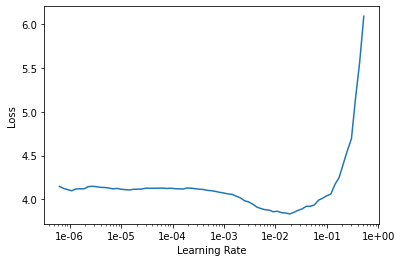

In [20]:
#finding optimal learning rate
en_learn.lr_find()
en_learn.recorder.plot()

In [21]:
#running the model with 15 epochs
en_learn.fit_one_cycle(15, max_lr=1e-03)

epoch,train_loss,valid_loss,accuracy,top_k_accuracy,top_k_accuracy,time
0,1.406182,1.189939,0.662125,0.662125,0.922450,40:01
1,1.359047,1.331736,0.617275,0.617275,0.914100,39:44
2,1.398537,1.287549,0.637400,0.637400,0.910100,39:48
3,1.374073,1.254198,0.638950,0.638950,0.913975,39:38
4,1.272256,1.175379,0.658375,0.658375,0.924650,39:48
5,1.241133,1.179366,0.658875,0.658875,0.923200,39:42
6,1.198199,1.122766,0.675325,0.675325,0.929500,39:44
7,1.148672,1.085559,0.685400,0.685400,0.931975,39:46
8,1.102846,1.067446,0.692500,0.692500,0.935075,39:49
9,0.996767,1.032256,0.702150,0.702150,0.940625,39:55


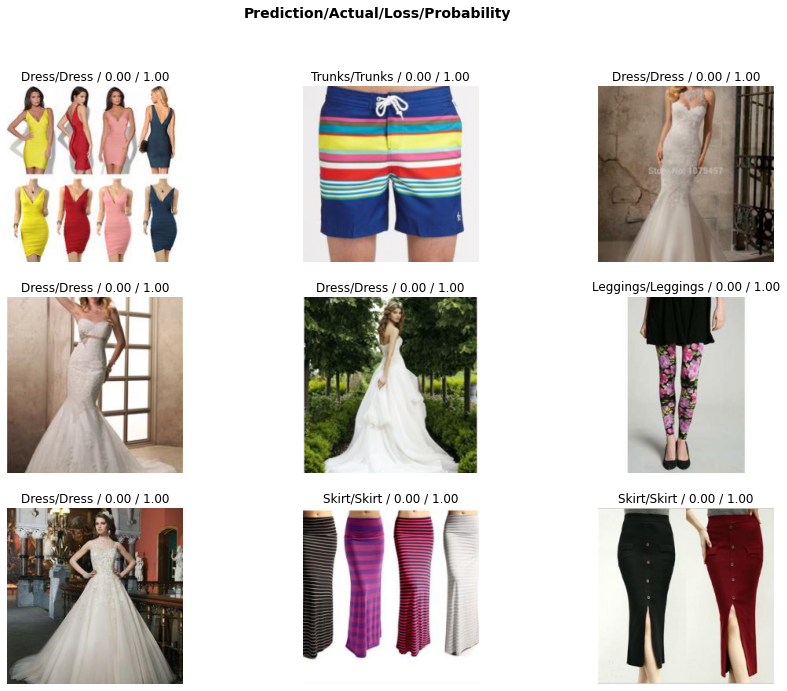

In [22]:
#showing 
interp = ClassificationInterpretation.from_learner(en_learn)
interp.plot_top_losses(9, largest=False, figsize=(15,11), heatmap_thresh=5)

In [23]:
# saving the model results to results folder
drive.mount('/content/gdrive')
en_learn.save('/content/gdrive/Shared drives/DATS6501 Capstone Group 1/Results/EfficientNet-fashion-2')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [24]:
en_learn.model.module

EfficientNet(
  (_conv_stem): Conv2dStaticSamePadding(
    3, 40, kernel_size=(3, 3), stride=(2, 2), bias=False
    (static_padding): ZeroPad2d(padding=(0, 1, 0, 1), value=0.0)
  )
  (_bn0): BatchNorm2d(40, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
  (_blocks): ModuleList(
    (0): MBConvBlock(
      (_depthwise_conv): Conv2dStaticSamePadding(
        40, 40, kernel_size=(3, 3), stride=[1, 1], groups=40, bias=False
        (static_padding): ZeroPad2d(padding=(1, 1, 1, 1), value=0.0)
      )
      (_bn1): BatchNorm2d(40, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
      (_se_reduce): Conv2dStaticSamePadding(
        40, 10, kernel_size=(1, 1), stride=(1, 1)
        (static_padding): Identity()
      )
      (_se_expand): Conv2dStaticSamePadding(
        10, 40, kernel_size=(1, 1), stride=(1, 1)
        (static_padding): Identity()
      )
      (_project_conv): Conv2dStaticSamePadding(
        40, 24, kernel_siz

# **Recommendation System**

## Using Fast.AI to get Image Embeddings

In [25]:
#defining forward hooks to save feature layers
class SaveFeatures():
    features=None
    def __init__(self, m): 
        self.hook = m.register_forward_hook(self.hook_fn)
        self.features = None
    def hook_fn(self, module, input, output): 
        out = output.detach().cpu().numpy()
        if isinstance(self.features, type(None)):
            self.features = out
        else:
            self.features = np.row_stack((self.features, out))
    def remove(self): 
        self.hook.remove()

In [26]:
#loading the trained B3 model to use for recommendation since that had higher accuracy
def load_learner(data, pretrained_model, model_metrics, model_path):
    en_learn = Learner(data, ef_model, metrics=model_metrics)
    en_learn.model = torch.nn.DataParallel(en_learn.model)
    en_learn = en_learn.load(model_path)
    return en_learn

model_metrics = [accuracy, partial(top_k_accuracy, k=1), partial(top_k_accuracy, k=5)]

#mount gdrive
drive.mount('/content/gdrive') 

ef_model = EfficientNet.from_pretrained('efficientnet-b3') 
ef_head = create_head(1536, data.c, concat_pool=False)
ef_head = nn.Sequential(*(list(ef_head.children())[3:]))
ef_model._fc = ef_head

pretrained_model = EfficientNet.from_pretrained('efficientnet-b3') 
model_path = "/content/gdrive/Shared drives/DATS6501 Capstone Group 1/Results/EfficientNet-fashion-2"

en_learn = load_learner(data, pretrained_model, model_metrics, model_path)

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).
Loaded pretrained weights for efficientnet-b3
Loaded pretrained weights for efficientnet-b3


In [27]:
#
saved_features = SaveFeatures(en_learn.model.module)
_= en_learn.get_preds(data.train_ds)
_= en_learn.get_preds(DatasetType.Valid)

In [28]:
# get the embeddings for the trained model
img_path = [str(x) for x in (list(data.train_ds.items) +list(data.valid_ds.items))]
label = [data.classes[x] for x in (list(data.train_ds.y.items) +list(data.valid_ds.y.items))]
label_id = [x for x in (list(data.train_ds.y.items) +list(data.valid_ds.y.items))]
data_df_ouput = pd.DataFrame({'img_path': img_path, 'label': label, 'label_id': label_id})
data_df_ouput['embeddings'] = np.array(saved_features.features).tolist()
data_df_ouput

,img_path,label,label_id,embeddings
0,/content/img/Sheer_Pleated-Front_Blouse/img_00...,Blouse,2,"[-13.912389755249023, -4.778195858001709, 1.23..."
1,/content/img/Sheer_Pleated-Front_Blouse/img_00...,Blouse,2,"[-7.128288269042969, -1.7061351537704468, 2.88..."
2,/content/img/Sheer_Pleated-Front_Blouse/img_00...,Blouse,2,"[-12.985112190246582, -5.575062274932861, 2.33..."
3,/content/img/Sheer_Pleated-Front_Blouse/img_00...,Blouse,2,"[-12.045754432678223, -5.820242404937744, 2.19..."
4,/content/img/Sheer_Pleated-Front_Blouse/img_00...,Blouse,2,"[-6.880012512207031, -1.0430984497070312, 3.12..."
...,...,...,...,...
249217,/content/img/Paisley_Print_Babydoll_Dress/img_...,Dress,13,"[-2.911275863647461, -1.8871474266052246, 0.69..."
249218,/content/img/Paisley_Print_Babydoll_Dress/img_...,Dress,13,"[-6.231718063354492, -4.8266377449035645, -1.0..."
249219,/content/img/Paisley_Print_Babydoll_Dress/img_...,Dress,13,"[-9.607325553894043, -8.380553245544434, -6.61..."
249220,/content/img/Paisley_Print_Babydoll_Dress/img_...,Dress,13,"[-14.220738410949707, -12.268267631530762, -8...."


In [29]:
def get_similar_images_annoy(annoy_tree, img_index, number_of_items=12):
    start = time.time()
    img_id, img_label  = data_df_ouput.iloc[img_index, [0, 1]]
    similar_img_ids = annoy_tree.get_nns_by_item(img_index, number_of_items+1)
    end = time.time()
    print(f'{(end - start) * 1000} ms')
    return img_id, img_label, data_df_ouput.iloc[similar_img_ids[1:]] 

# for images similar to centroid 
def get_similar_images_annoy_centroid(annoy_tree, vector_value, number_of_items=12):
    start = time.time()
    similar_img_ids = annoy_tree.get_nns_by_vector(vector_value, number_of_items)
    end = time.time()
    print(f'{(end - start) * 1000} ms')
    return data_df_ouput.iloc[similar_img_ids] 


def show_similar_images(similar_images_df, fig_size=[10,10], hide_labels=True):
    if hide_labels:
        category_list = []
        for i in range(len(similar_images_df)):
            # replace category with blank so it wont show in display
            category_list.append(CategoryList(similar_images_df['label_id'].values*0,
                                              [''] * len(similar_images_df)).get(i))
    else:
        category_list = [en_learn.data.train_ds.y.reconstruct(y) for y in similar_images_df['label_id']]
    return en_learn.data.show_xys([open_image(img_id) for img_id in similar_images_df['img_path']],
                                category_list, figsize=fig_size)

In [30]:
# higher n_tree = better accuracy
ntree = 100

#metric can be angular, euclidean, manhattan, hamming, or dot - we chose angular because this is what spotify uses 
metric_choice = 'angular'

#assiging index that is read-write and based on metric choice
annoy_tree = AnnoyIndex(len(data_df_ouput['embeddings'][0]), metric=metric_choice)

for i, vector in enumerate(data_df_ouput['embeddings']):
    annoy_tree.add_item(i, vector)
_  = annoy_tree.build(ntree)

In [31]:
def centroid_embedding(outfit_embedding_list):
    number_of_outfits = outfit_embedding_list.shape[0]
    length_of_embedding = outfit_embedding_list.shape[1]
    centroid = []
    for i in range(length_of_embedding):
        centroid.append(np.sum(outfit_embedding_list[:, i])/number_of_outfits)
    return centroid

In [32]:
#function 
def get_similar_image(outfit_img_ids):
    outfit_embedding_list = []
    for img_index in outfit_img_ids:
        outfit_embedding_list.append(data_df_ouput.iloc[img_index, 3])

    outfit_embedding_list = np.array(outfit_embedding_list)
    outfit_centroid_embedding = centroid_embedding(outfit_embedding_list)
    outfits_selected = data_df_ouput.iloc[outfit_img_ids] 

    similar_images_df = get_similar_images_annoy_centroid(annoy_tree, outfit_centroid_embedding, 30)
    show_similar_images(similar_images_df, fig_size=[15,15])

200427


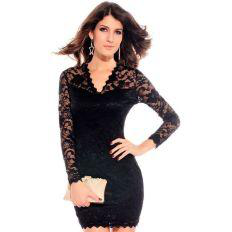

In [33]:
#
img_index = np.random.randint(len(data_df_ouput),size=1)[0]

print(img_index)
open_image(data_df_ouput.iloc[img_index, 0])

## Style/Weather Groupings

In [34]:
#manually creating groups of image that fit the style/weather categories 
freeze_casual_id = [221532, 163433, 117678, 64942, 39660, 223217, 58109, 94611, 221515, 26747, 227272, 84616, 55707, 209458, 43254, 97048, 95193, 60360]
freeze_grunge_id = [65814, 111185, 43728, 223712, 33480, 46275, 118254, 55863, 232381, 7056, 94920, 99144, 14280]
freeze_classic_id = [242827, 86249, 81817, 60627, 215538, 59835, 165240, 6233, 213882, 23894, 141219, 227768, 34992, 20370, 144817, 39510, 175]
freeze_bohemian_id = [132177, 34579, 111550, 211175, 241034]
freeze_athletic_id = [135593, 87637, 28338, 116013, 53537, 219301, 43276, 227768, 73020, 63028]
freeze_preppy_id = [206226, 8656, 4748, 58108, 43437, 195979]
freeze_formal_id = [64086, 144630, 200784, 64311, 117433, 158176, 193070, 175717, 242248, 179228, 240139, 199354, 13631, 198107, 164813, 219882, 172936]

cold_casual_id = [81273, 79408, 118567, 213989, 83565, 121075, 50317, 23044, 207304, 17724, 14107, 11806, 117928, 9112, 15342, 215555, 91614, 214429, 82397]
cold_grunge_id = [236054, 64604, 236602, 2692, 51383, 81807, 30779, 34107, 64618, 82885, 119845, 80609, 165130]
cold_classic_id = [110279, 150851, 76643, 8744, 72527, 245026, 8526, 158881, 63415, 80261, 67881, 50578, 6013, 13478, 158900, 760, 2535, 12619, 5744, 230491]
cold_bohemian_id = [160240, 124406, 172592, 209491, 23334, 168877, 182538, 235205]
cold_athletic_id = [219215, 136171, 134258, 103551, 221536, 73767, 138930, 122096]
cold_preppy_id = [15582, 24912, 172574, 15558, 131221, 22389]
cold_formal_id = [239925, 194801, 218899, 16797, 173857, 155328, 197223, 180884, 146594, 237259, 168657, 245849, 143785, 202463, 185595, 152209, 207294, 67944]

mild_casual_id = [101633, 63674, 177705, 58042, 77343, 95691, 74345, 56503, 127400, 33111, 220615, 54360, 24402, 200841]
mild_grunge_id = [109436, 30014, 37717, 29257, 126229, 214345, 74765, 129086, 5492, 138063, 69789, 63245, 40908, 67420, 36107]
mild_classic_id = [146804, 60409, 23054, 87604, 219122, 5462, 136114, 158297, 5037, 209674, 230069, 220788, 92765, 114627, 17929, 139446, 82554, 34952, 95535, 139263, 175386]
mild_bohemian_id = [168146, 128610, 170588, 145441, 170217, 35638, 10061, 184764, 51639, 105770, 111722, 21873, 122883]
mild_athletic_id = [121820, 102688, 25134, 124003, 121860, 135333, 223258, 84916, 231320, 42164]
mild_preppy_id = [112573, 8054, 125929, 52756, 30163, 208168, 7744, 103212, 98539]
mild_formal_id  = [193078, 143869, 205708, 96584, 233887, 181184, 191556, 157730, 174889, 202740, 146357, 195707, 185440, 172091, 193590, 189901, 204776, 169264]

warm_casual_id = [85399, 92188, 157856, 185644, 243954, 87603, 76861, 88294, 69490, 36782, 104028, 216133, 107373, 205655, 217166, 18001, 147107, 72219, 185158]
warm_grunge_id = [47118, 227255, 158210, 226801, 106213, 157494, 195407, 217716, 155699]
warm_classic_id = [202081, 11977, 194187, 115244, 246222, 176874, 178933, 14481, 119362, 146138, 212145, 242346, 166774, 146876, 151943, 97365, 171787, 144345, 240324]
warm_bohemian_id = [26873, 81812, 192793, 90627, 171655, 9028, 27306, 152826, 27425, 166556, 196732, 203114, 208061, 97982, 105744, 37823, 185001, 109647]
warm_athletic_id = [134868, 53219, 32004, 117099, 233315, 88161, 231967, 232380]
warm_preppy_id = [131399, 8778, 125891, 140565, 171710, 114945, 153289]
warm_formal_id = [208946, 199777, 191099, 206501, 202154, 241478, 150684, 246929, 178186, 183048, 168084, 189049, 173192, 166719, 190238, 185976, 161360]

hot_casual_id = [183531, 106375, 230087, 239752, 108594, 31596, 224951, 141896, 48576, 6435, 152962, 23797, 119324, 245875, 232614, 133668, 158695, 124733, 22294]
hot_grunge_id = [123604, 35726, 141814, 93201, 230656, 138855, 24913, 135156, 183121, 83219]
hot_classic_id = [147261, 38697, 119131, 182109, 156437, 200859, 185453, 82621, 195648, 167026]
hot_bohemian_id = [13208, 179761, 79533, 92029, 193887, 204285, 153768, 153956, 152944, 222251, 141998, 196069, 137232, 238033, 19246, 197650, 186443, 54754, 142516, 118410, 103244]
hot_athletic_id = [128348, 141970, 133593, 108087, 84576, 133591, 135661, 53400, 127878, 105327]
hot_preppy_id = [166938, 188670, 127277, 105189, 126720, 133435]
hot_formal_id = [190562, 150336, 240933, 207764, 199541, 245231, 179368, 112209, 173811, 181218, 243328, 182876, 189242, 200149, 168515]

##Recommendations

### Freeze Selections

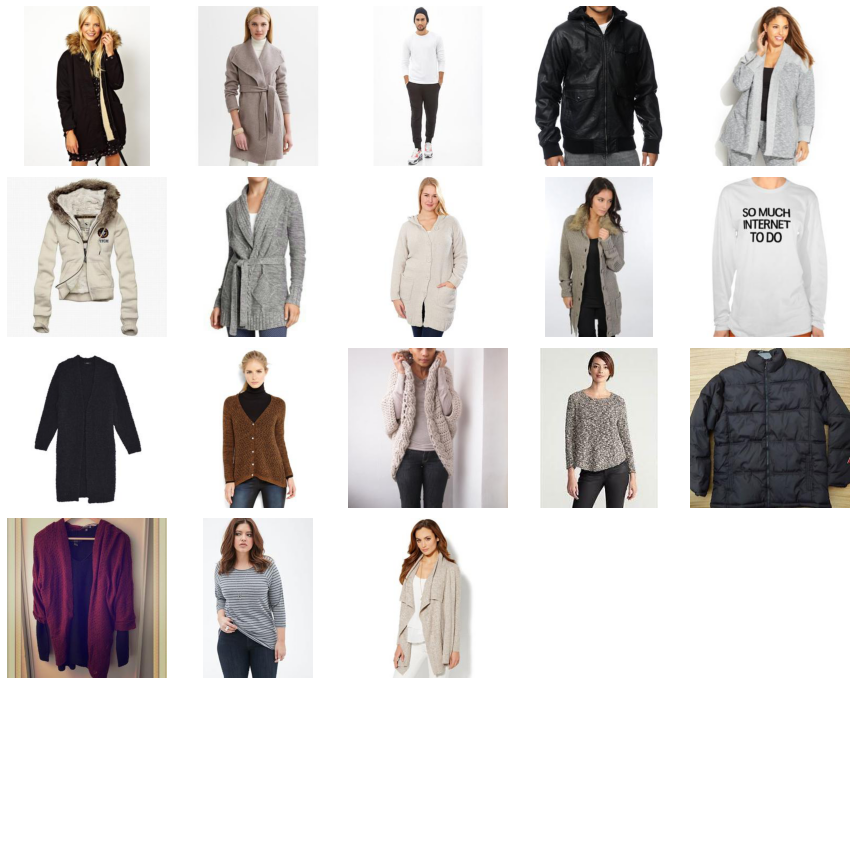

In [35]:
#use the show similar images function for each style/weather combo to view recommendations 
style_weather = data_df_ouput.iloc[freeze_casual_id] 
show_similar_images(style_weather, fig_size=[12,12])

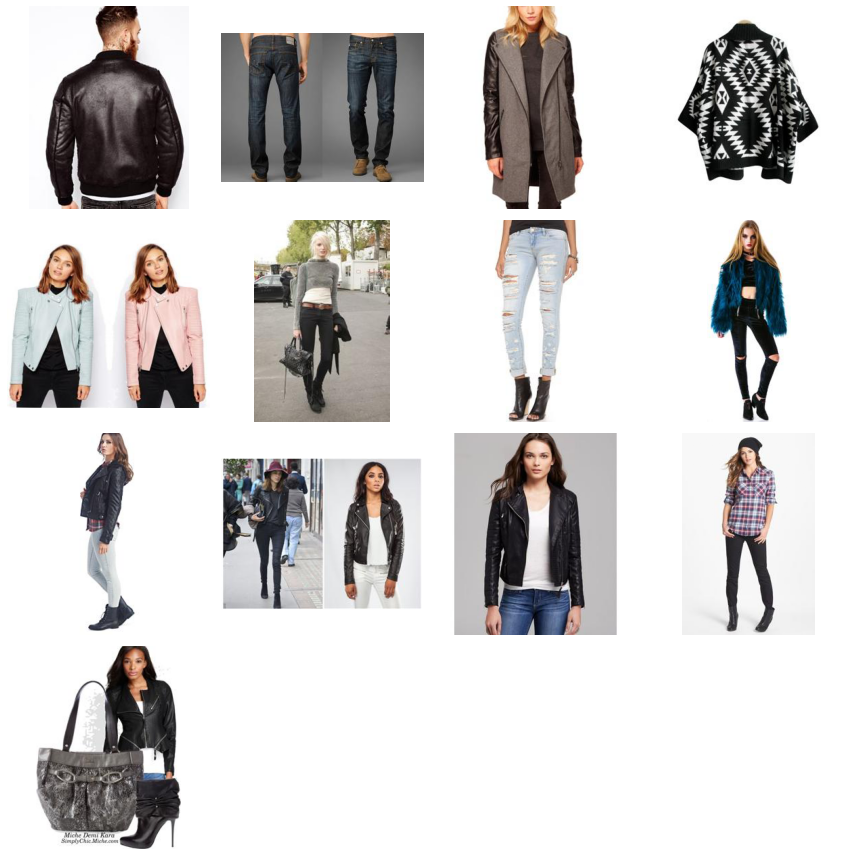

In [36]:
style_weather = data_df_ouput.iloc[freeze_grunge_id] 
show_similar_images(style_weather, fig_size=[12,12])

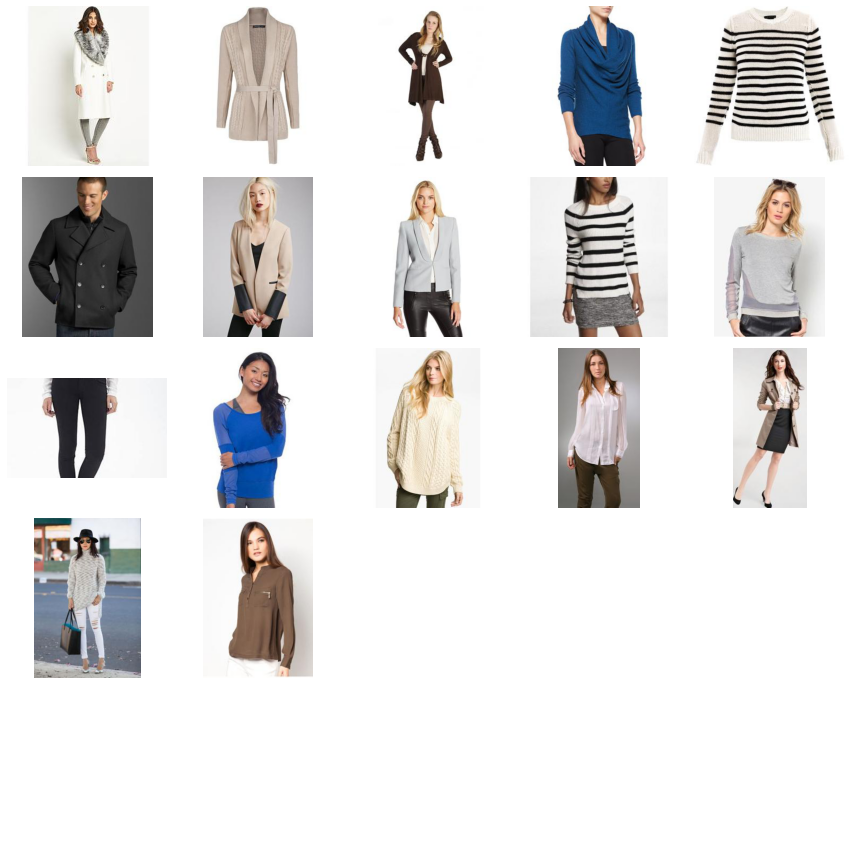

In [37]:
style_weather = data_df_ouput.iloc[freeze_classic_id] 
show_similar_images(style_weather, fig_size=[12,12])

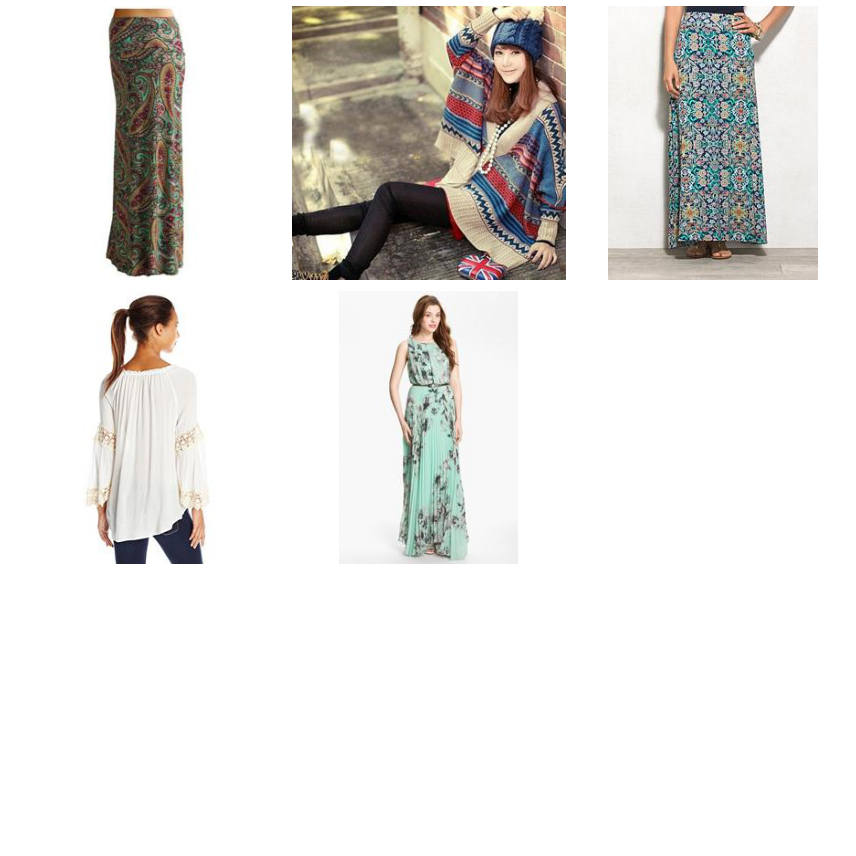

In [38]:
style_weather = data_df_ouput.iloc[freeze_bohemian_id] 
show_similar_images(style_weather, fig_size=[12,12])

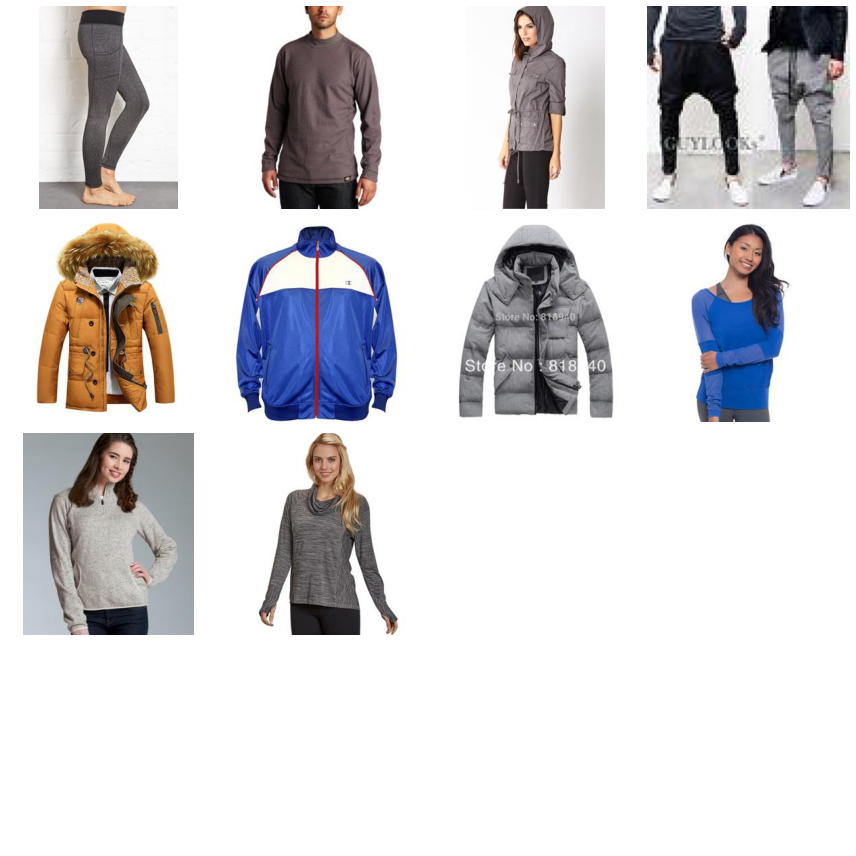

In [39]:
style_weather = data_df_ouput.iloc[freeze_athletic_id] 
show_similar_images(style_weather, fig_size=[12,12])

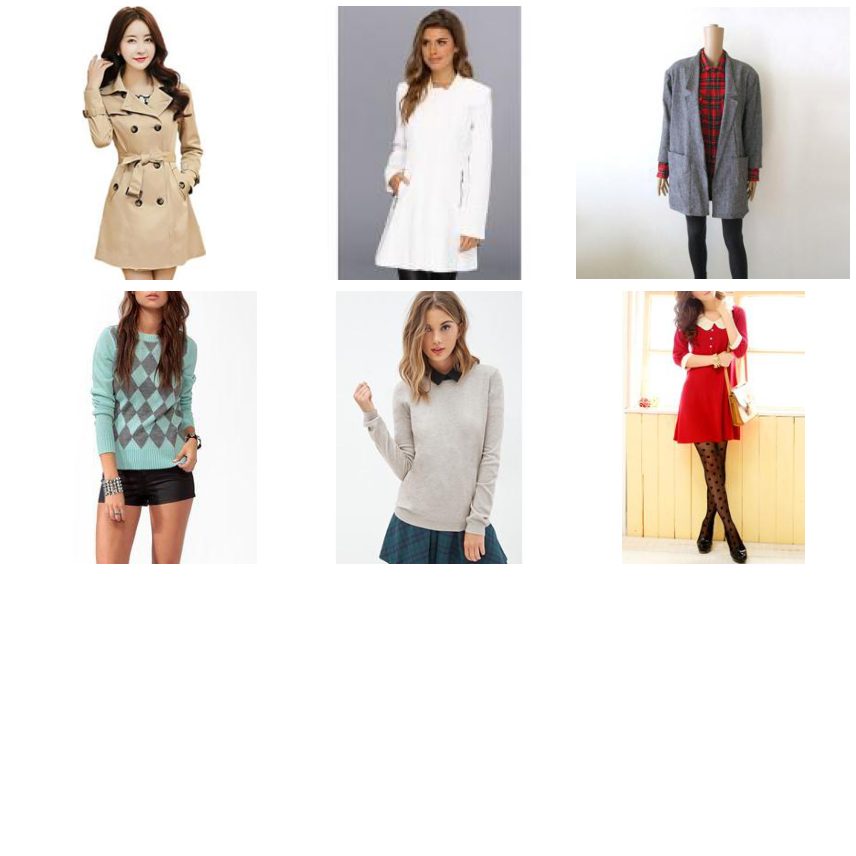

In [40]:
style_weather = data_df_ouput.iloc[freeze_preppy_id] 
show_similar_images(style_weather, fig_size=[12,12])

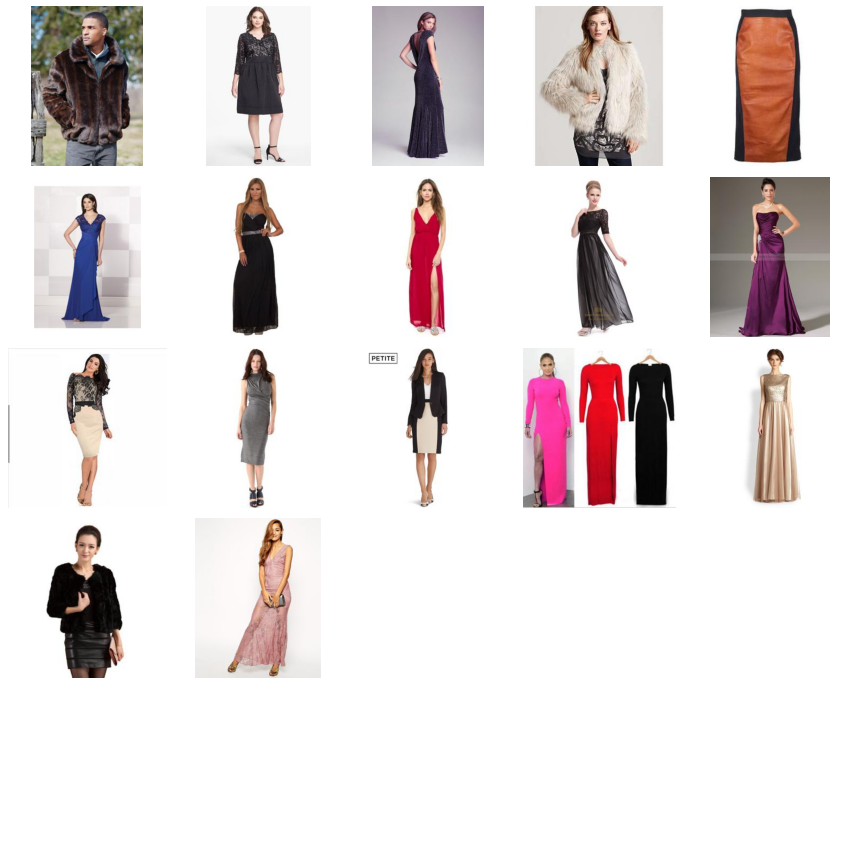

In [41]:
style_weather = data_df_ouput.iloc[freeze_formal_id] 
show_similar_images(style_weather, fig_size=[12,12])

### Cold Selections

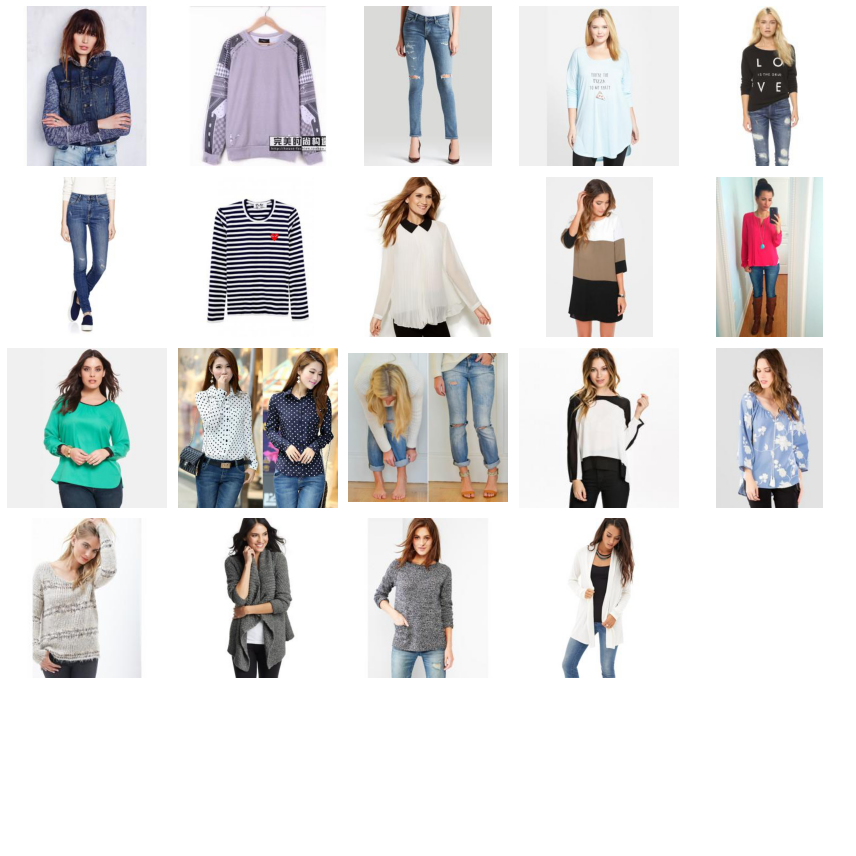

In [42]:
style_weather = data_df_ouput.iloc[cold_casual_id] 
show_similar_images(style_weather, fig_size=[12,12])

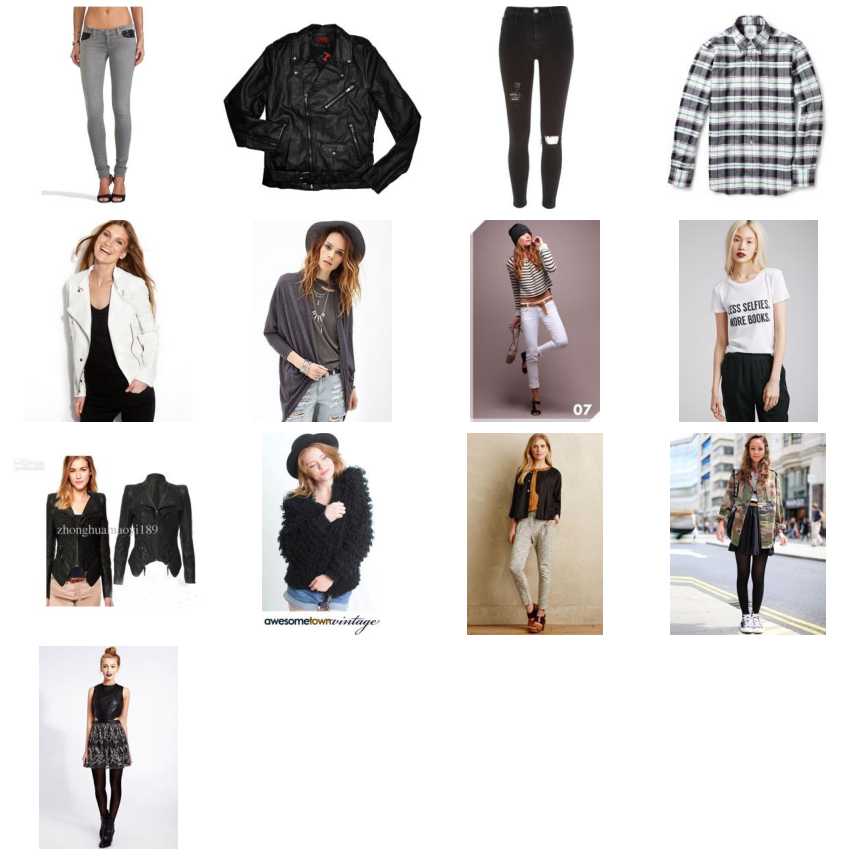

In [43]:
style_weather = data_df_ouput.iloc[cold_grunge_id] 
show_similar_images(style_weather, fig_size=[12,12])

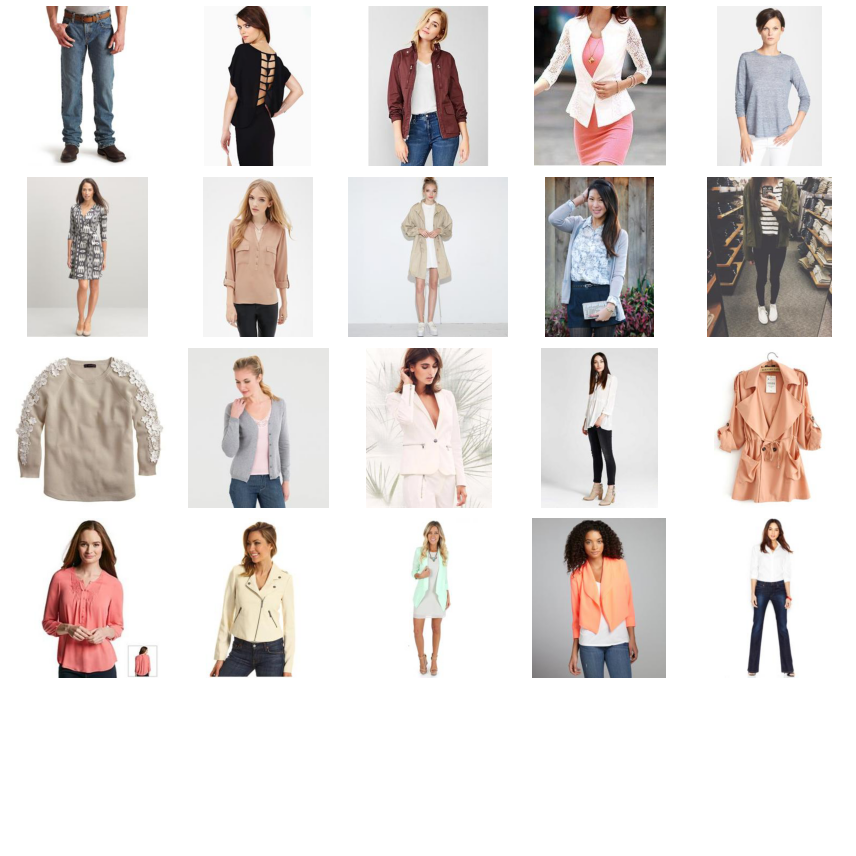

In [44]:
outfits_selected = data_df_ouput.iloc[cold_classic_id] 
show_similar_images(outfits_selected, fig_size=[12,12])

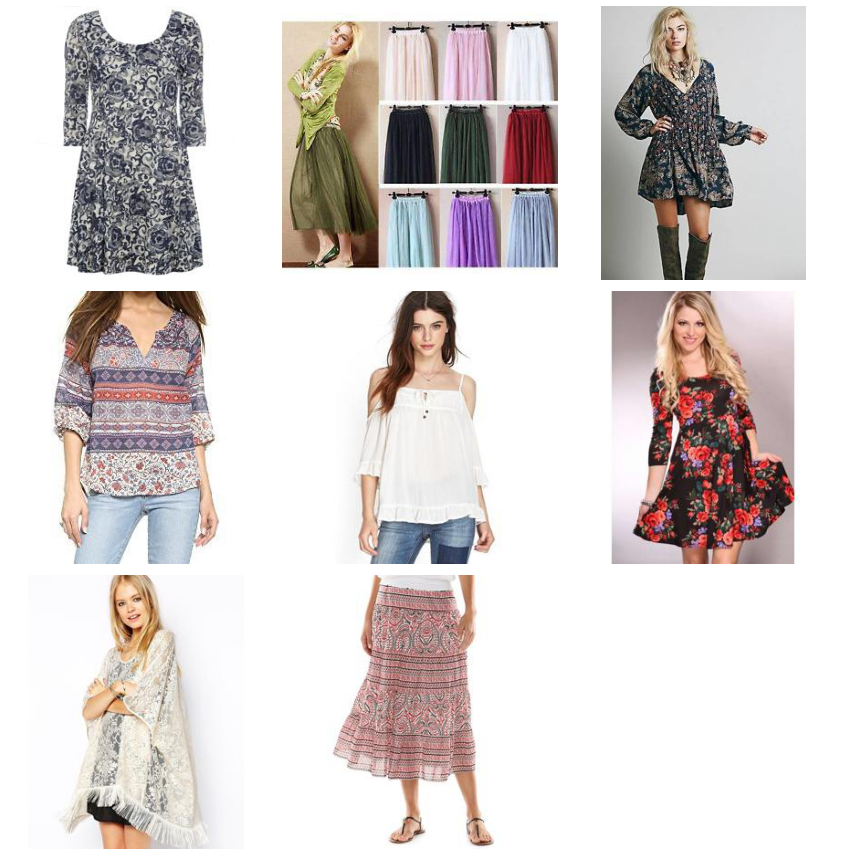

In [45]:
style_weather = data_df_ouput.iloc[cold_bohemian_id] 
show_similar_images(style_weather, fig_size=[12,12])

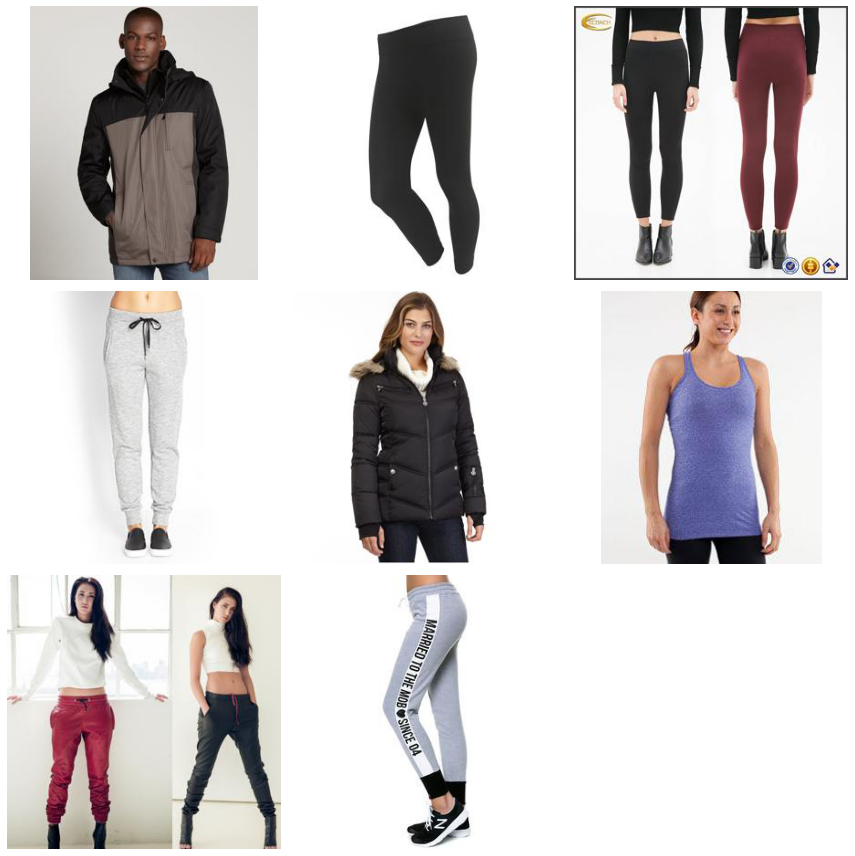

In [46]:
style_weather = data_df_ouput.iloc[cold_athletic_id] 
show_similar_images(style_weather, fig_size=[12,12])

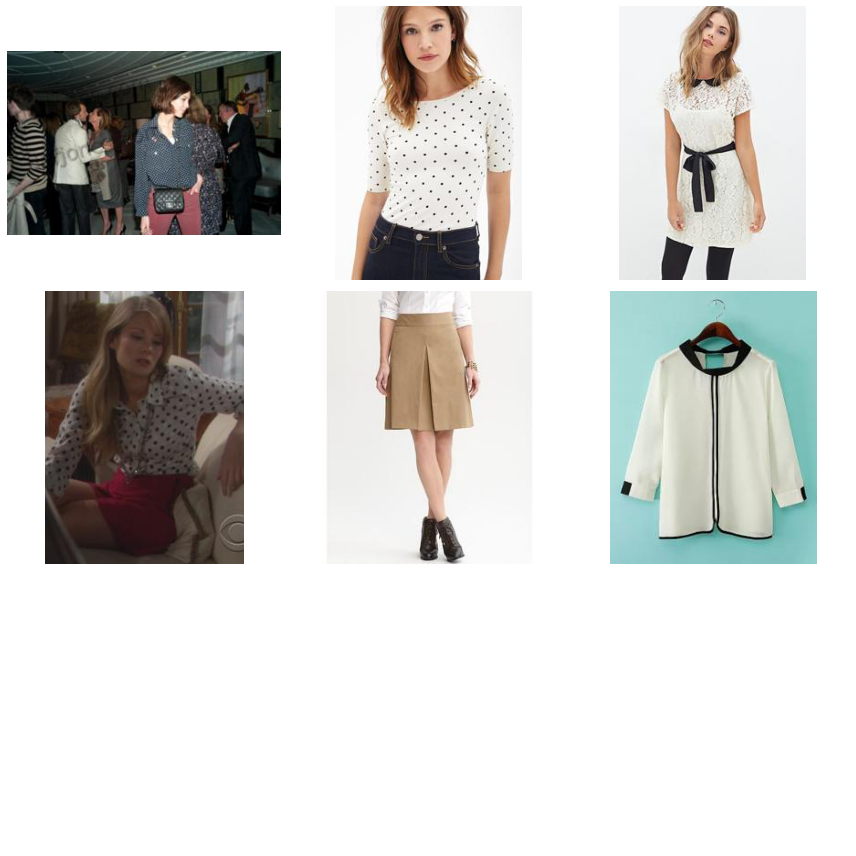

In [47]:
style_weather = data_df_ouput.iloc[cold_preppy_id] 
show_similar_images(style_weather, fig_size=[12,12])

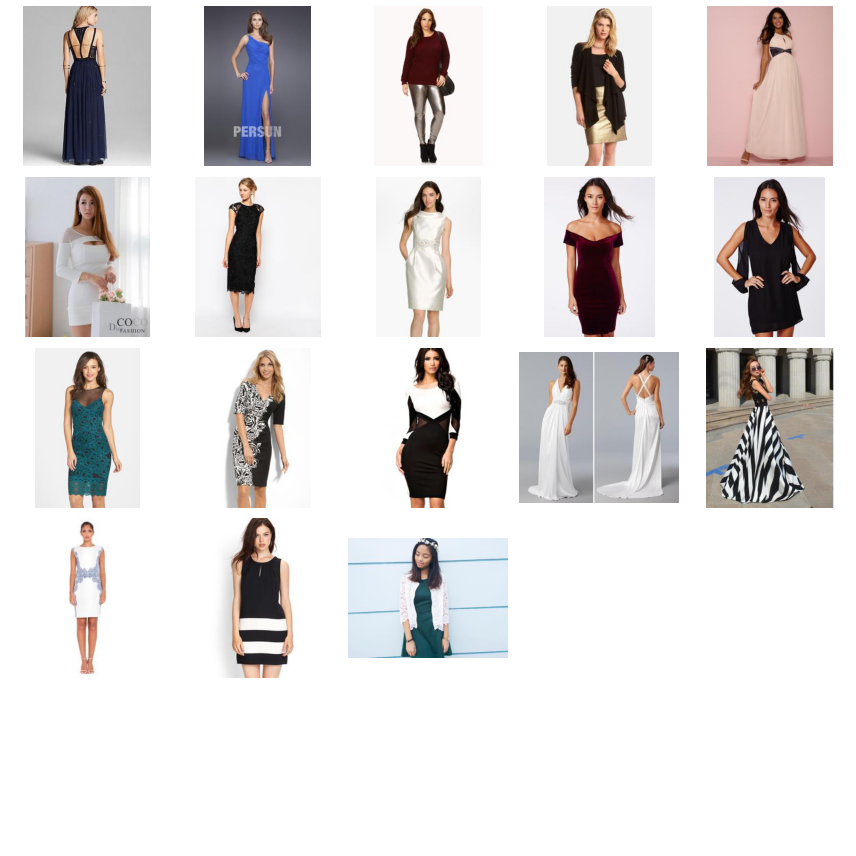

In [48]:
style_weather = data_df_ouput.iloc[cold_formal_id] 
show_similar_images(style_weather, fig_size=[12,12])

###Mild Selections

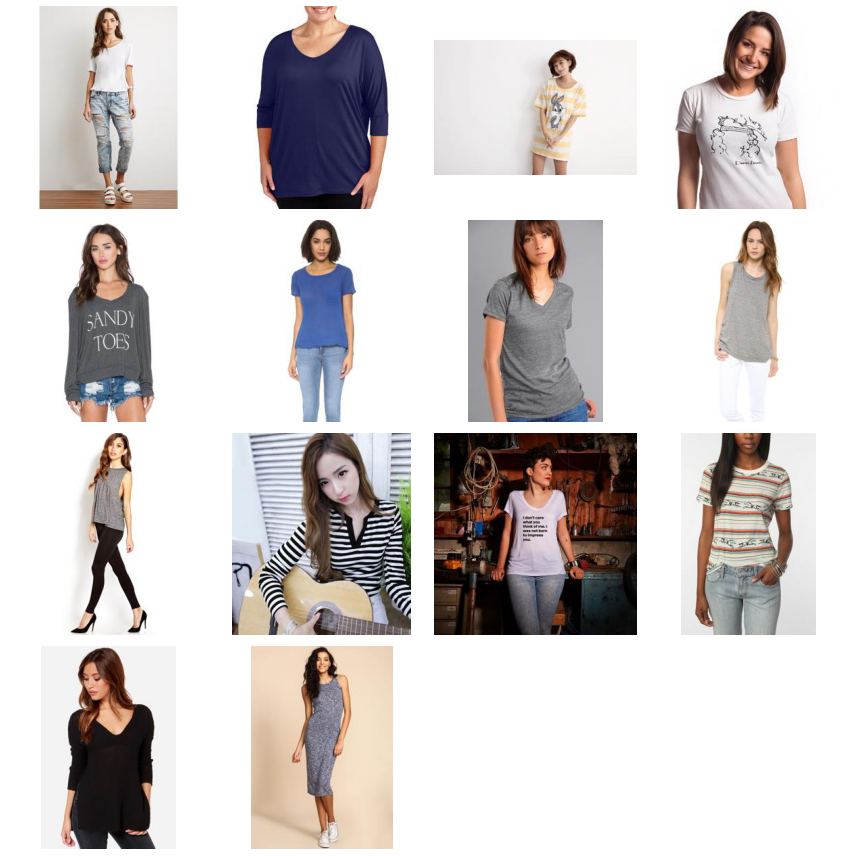

In [49]:
style_weather = data_df_ouput.iloc[mild_casual_id] 
show_similar_images(style_weather, fig_size=[12,12])

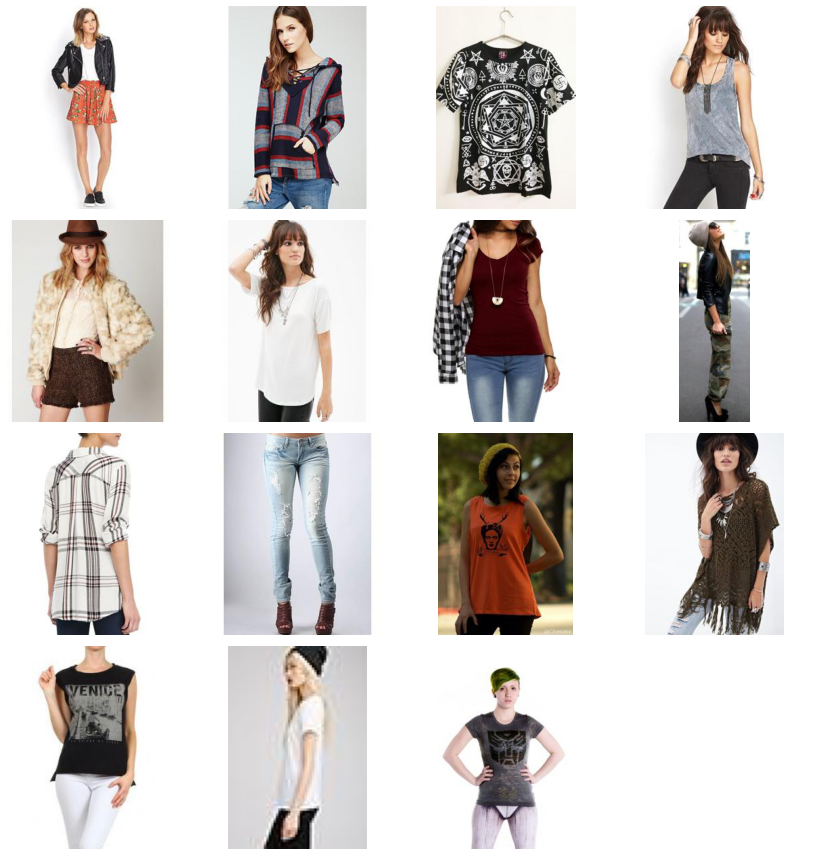

In [50]:
style_weather = data_df_ouput.iloc[mild_grunge_id] 
show_similar_images(style_weather, fig_size=[12,12])

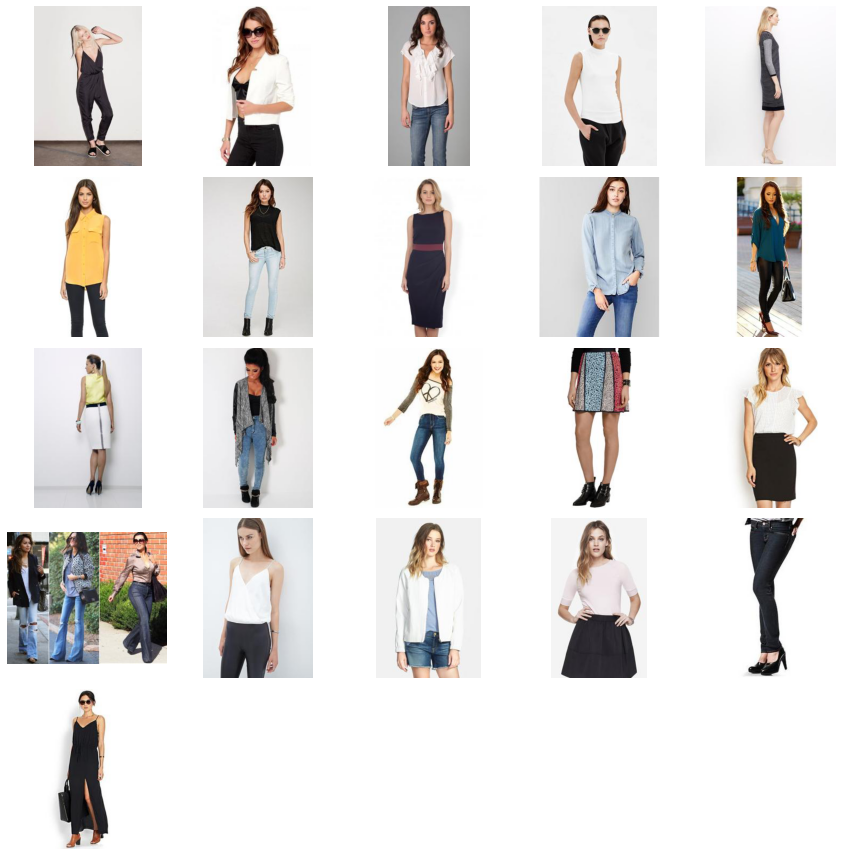

In [51]:
style_weather = data_df_ouput.iloc[mild_classic_id] 
show_similar_images(style_weather, fig_size=[12,12])

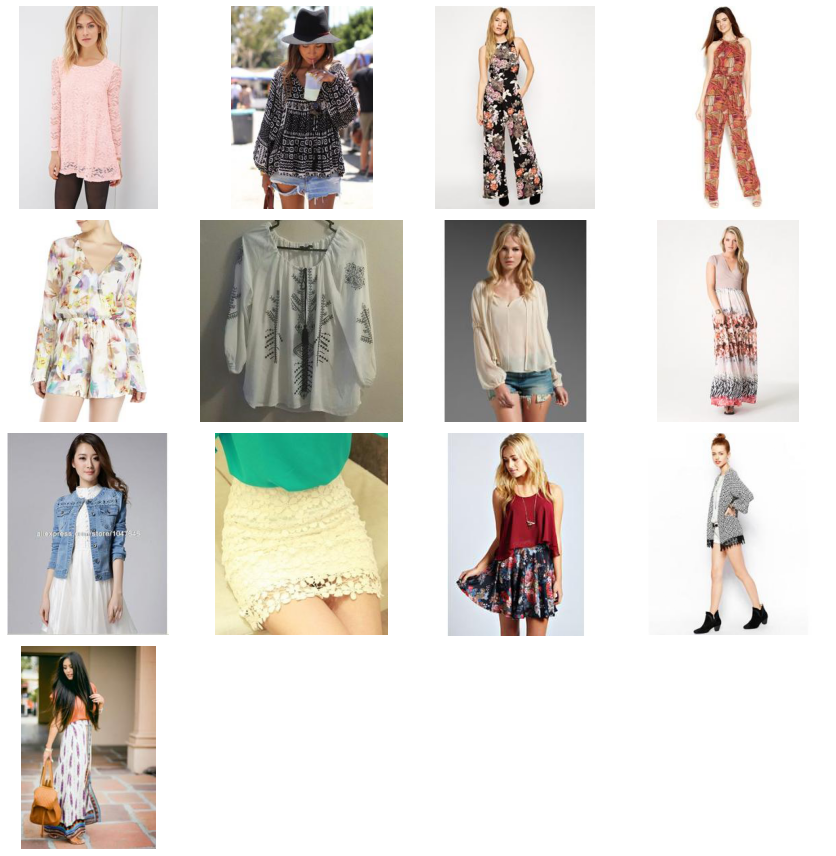

In [52]:
style_weather= data_df_ouput.iloc[mild_bohemian_id] 
show_similar_images(style_weather, fig_size=[12,12])

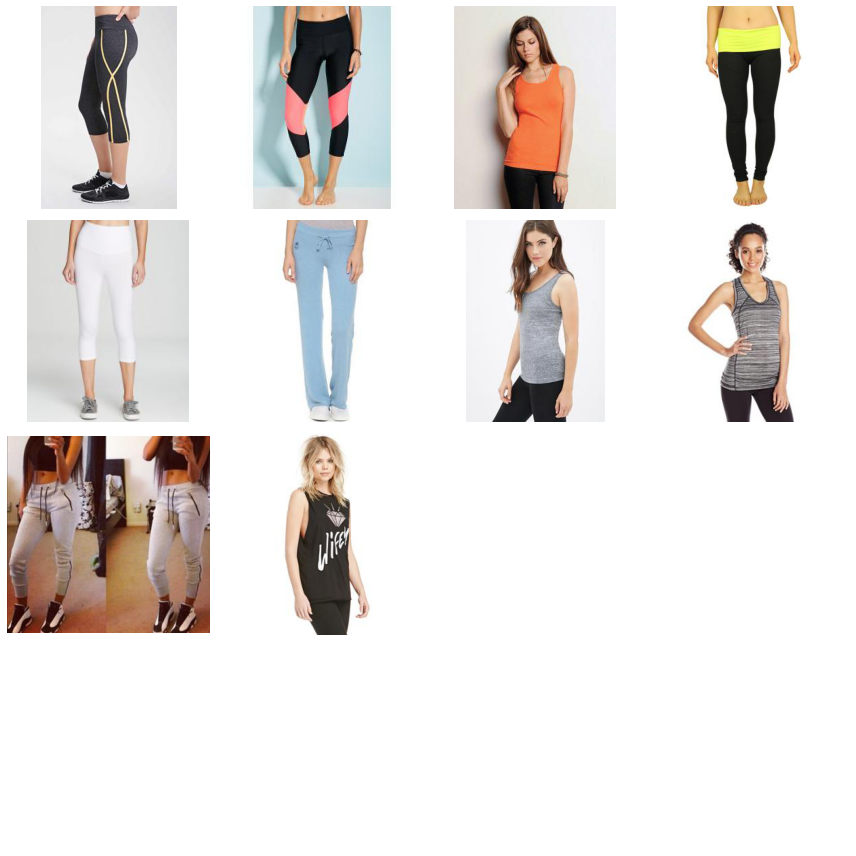

In [53]:
style_weather = data_df_ouput.iloc[mild_athletic_id] 
show_similar_images(style_weather, fig_size=[12,12])

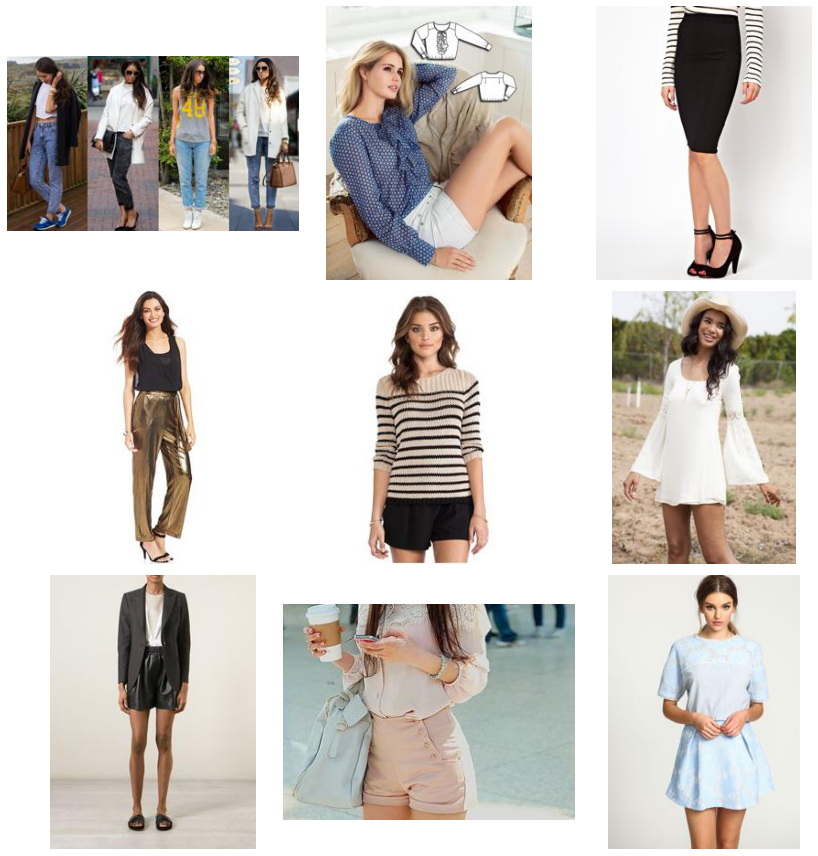

In [54]:
style_weather = data_df_ouput.iloc[mild_preppy_id] 
show_similar_images(style_weather, fig_size=[12,12])

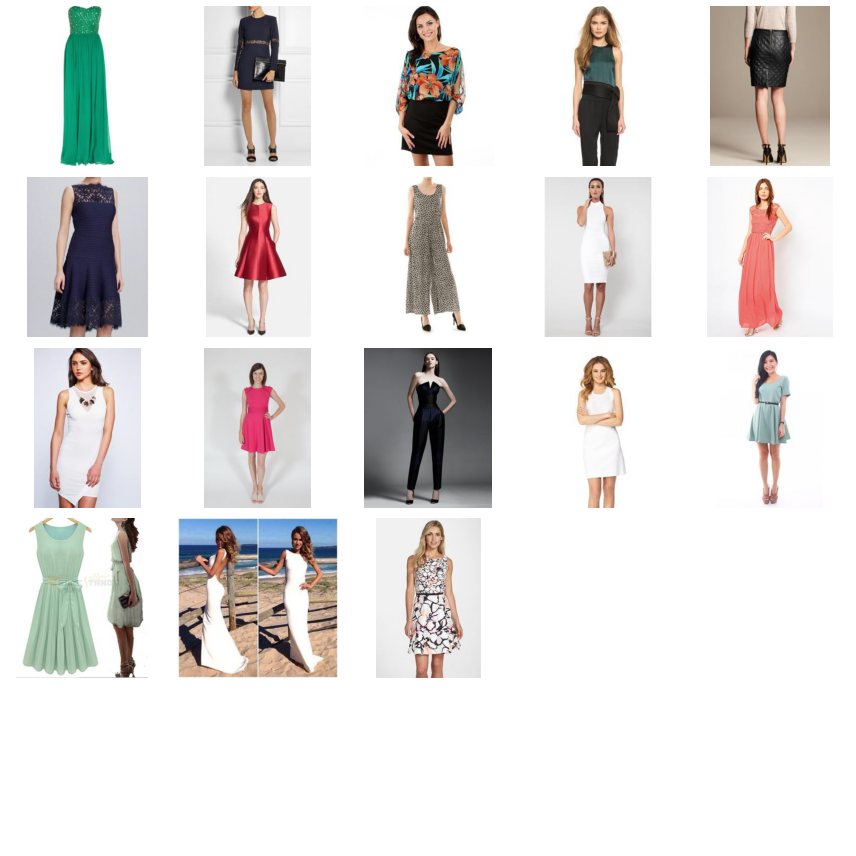

In [55]:
style_weather = data_df_ouput.iloc[mild_formal_id] 
show_similar_images(style_weather, fig_size=[12,12])

###Warm Selections

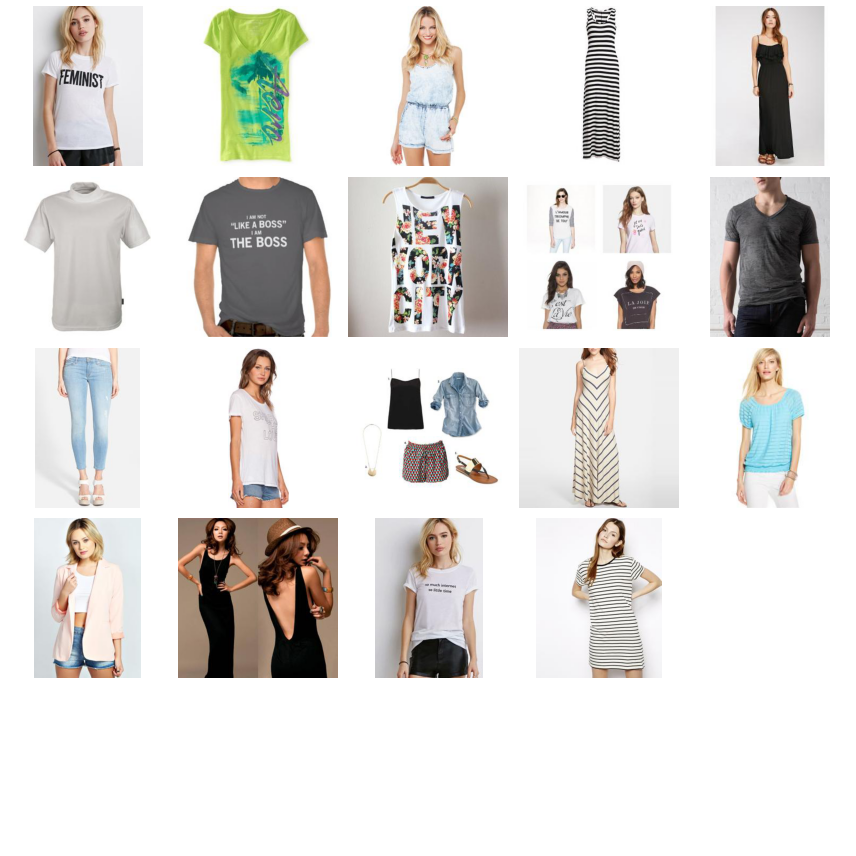

In [56]:
style_weather = data_df_ouput.iloc[warm_casual_id] 
show_similar_images(style_weather, fig_size=[12,12])

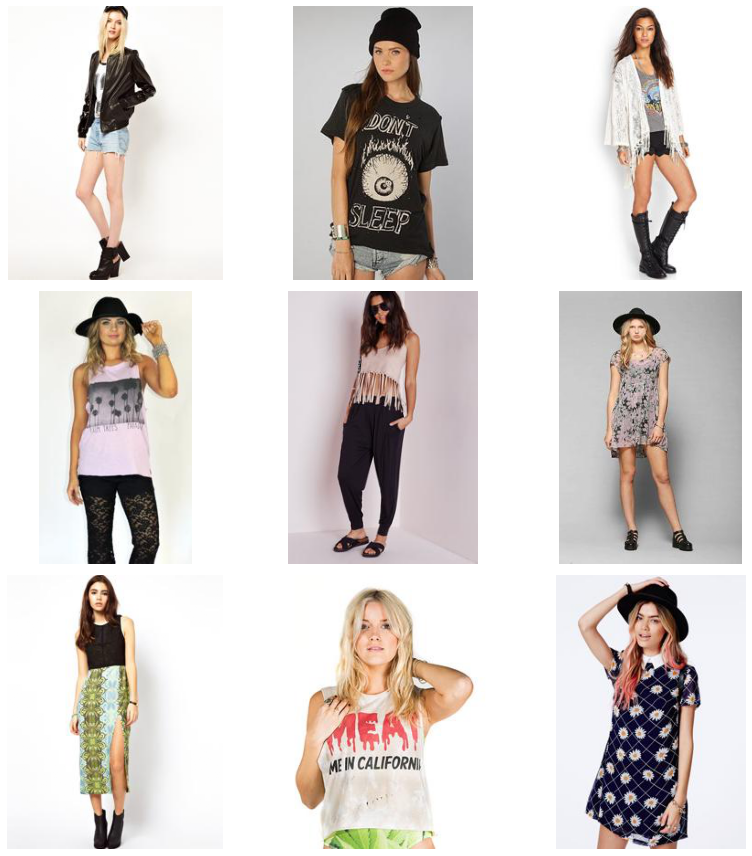

In [57]:
style_weather = data_df_ouput.iloc[warm_grunge_id] 
show_similar_images(style_weather, fig_size=[12,12])

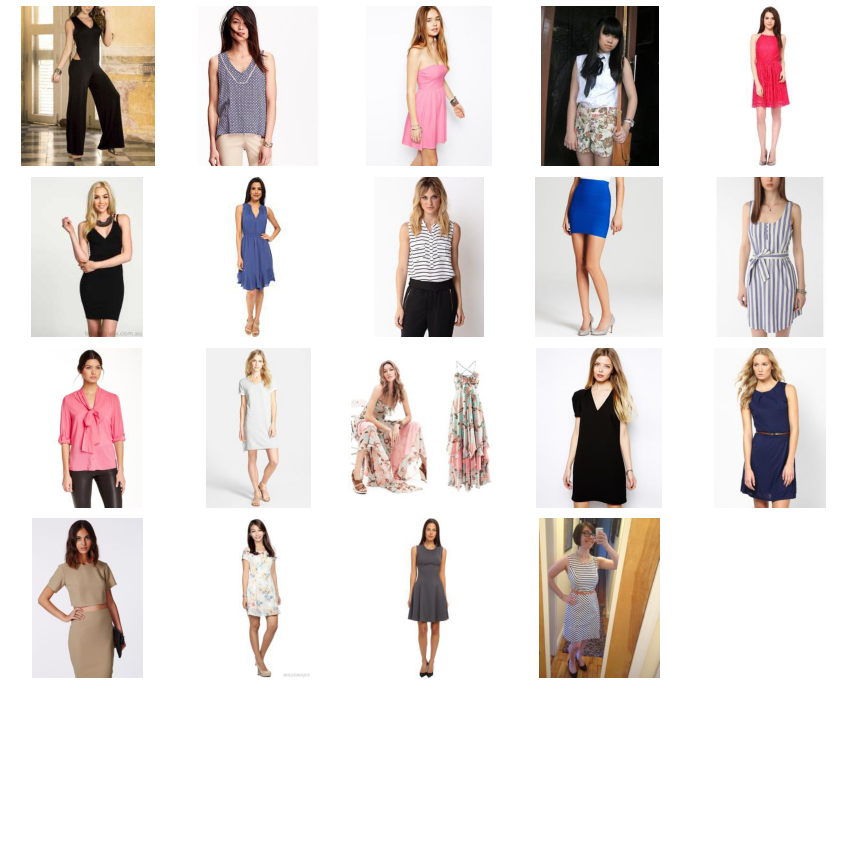

In [58]:
style_weather = data_df_ouput.iloc[warm_classic_id] 
show_similar_images(style_weather, fig_size=[12,12])

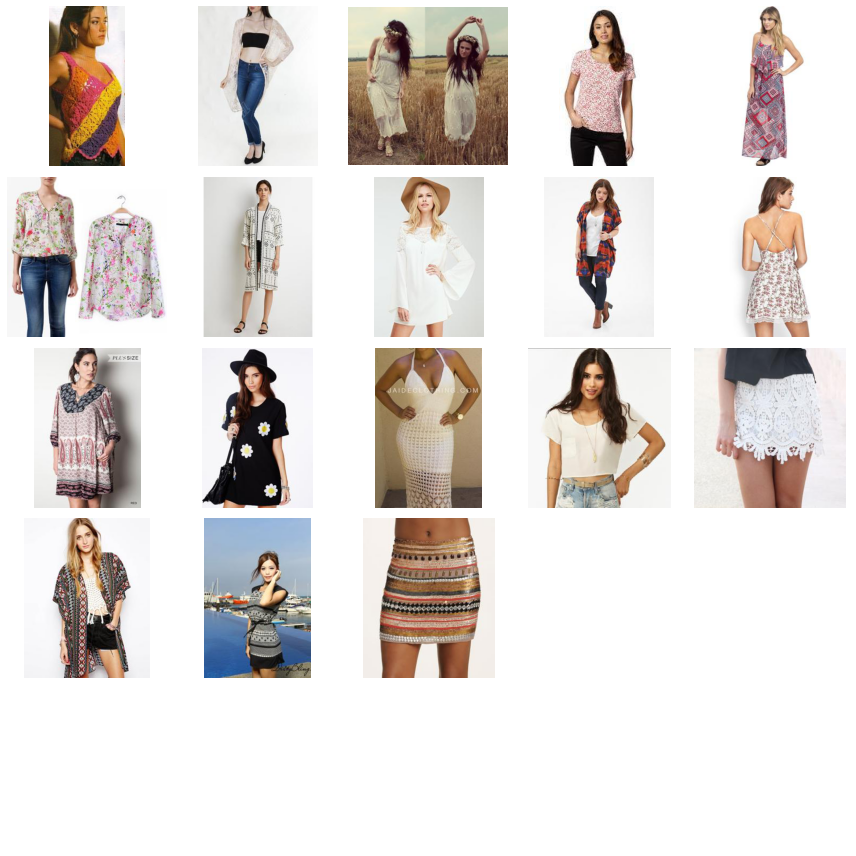

In [59]:
style_weather= data_df_ouput.iloc[warm_bohemian_id] 
show_similar_images(style_weather, fig_size=[12,12])

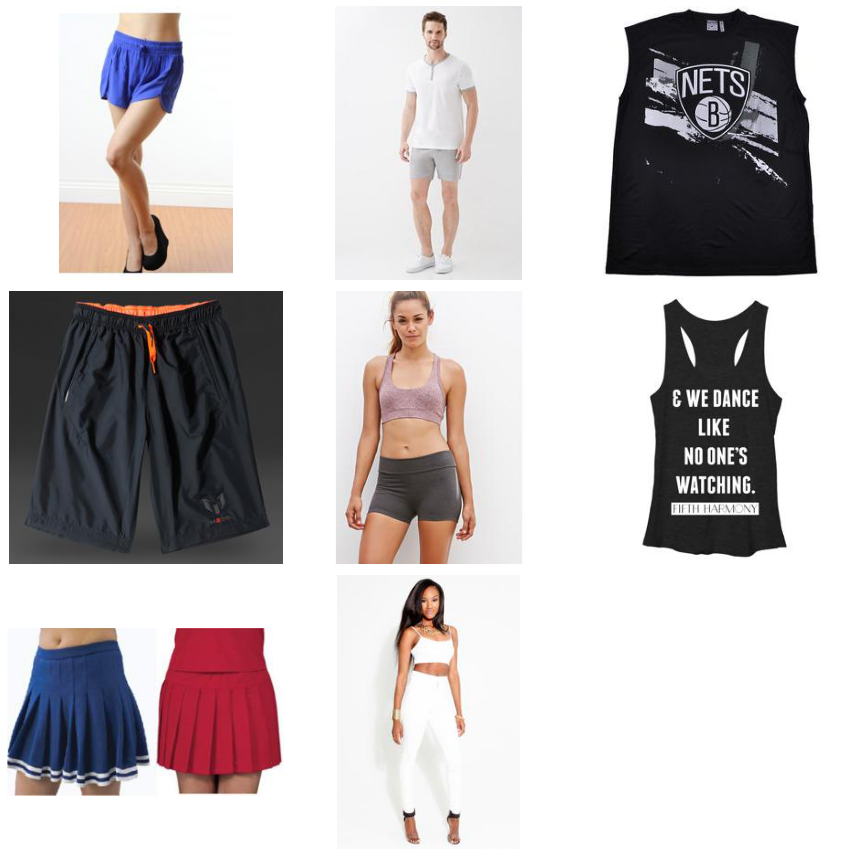

In [60]:
style_weather = data_df_ouput.iloc[warm_athletic_id] 
show_similar_images(style_weather, fig_size=[12,12])

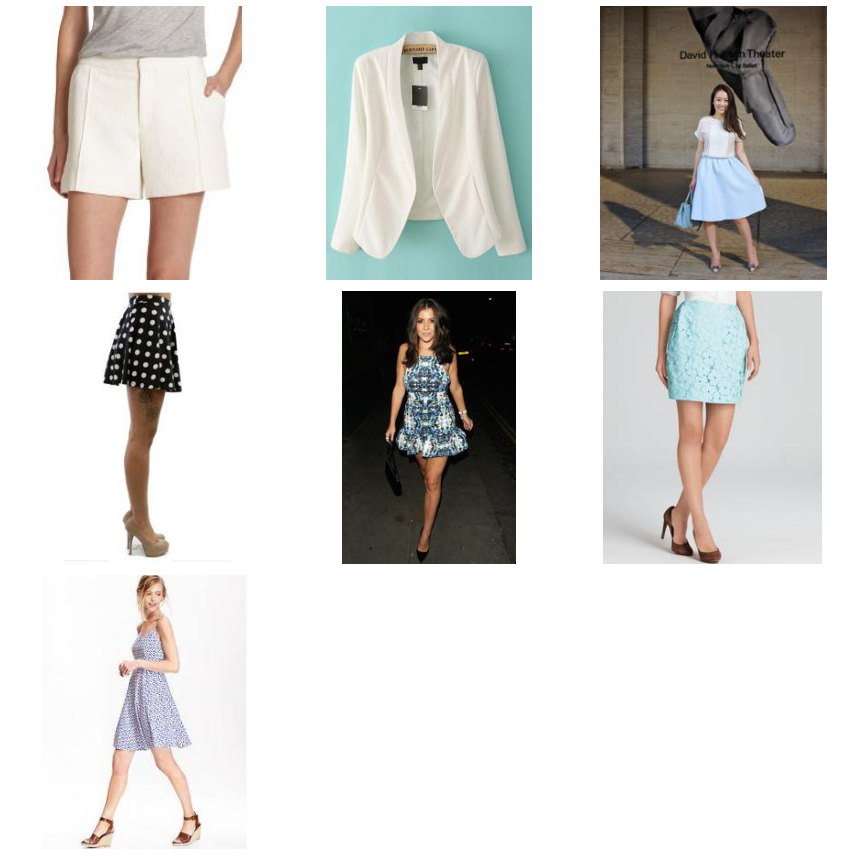

In [61]:
style_weather = data_df_ouput.iloc[warm_preppy_id] 
show_similar_images(style_weather, fig_size=[12,12])

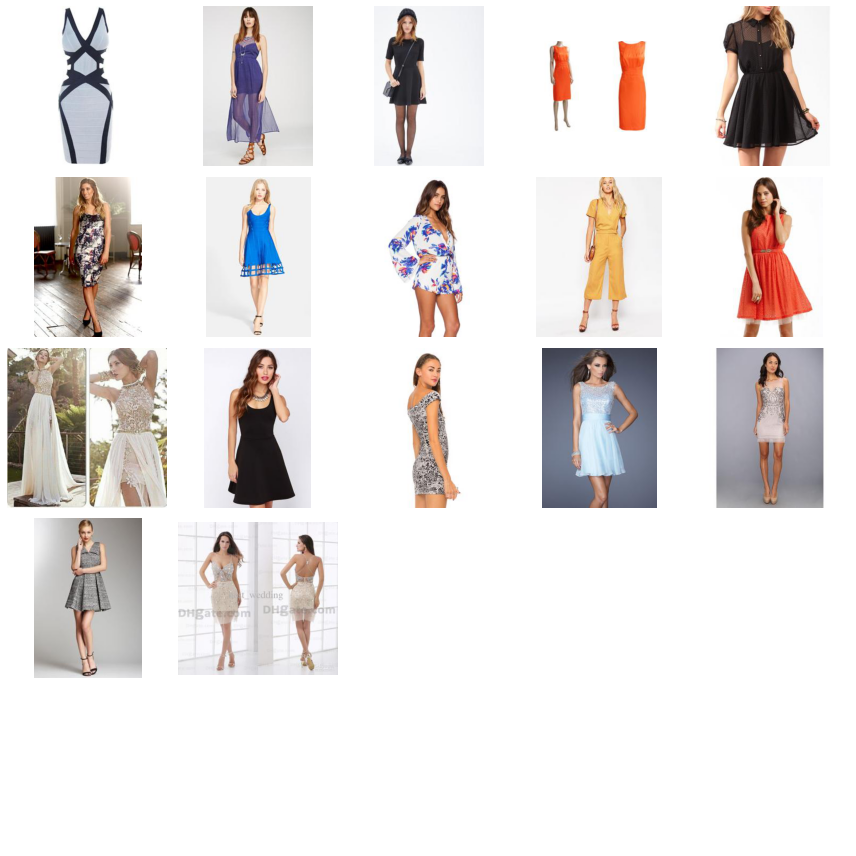

In [62]:
style_weather = data_df_ouput.iloc[warm_formal_id] 
show_similar_images(style_weather, fig_size=[12,12])

###Hot Selections

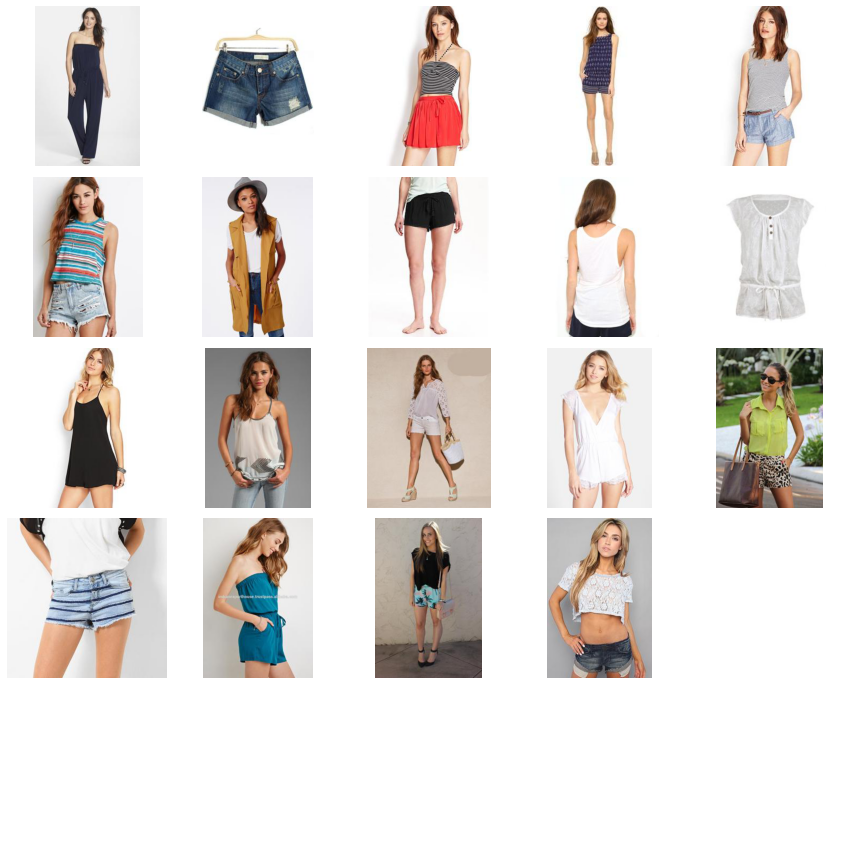

In [63]:
style_weather = data_df_ouput.iloc[hot_casual_id] 
show_similar_images(style_weather, fig_size=[12,12])

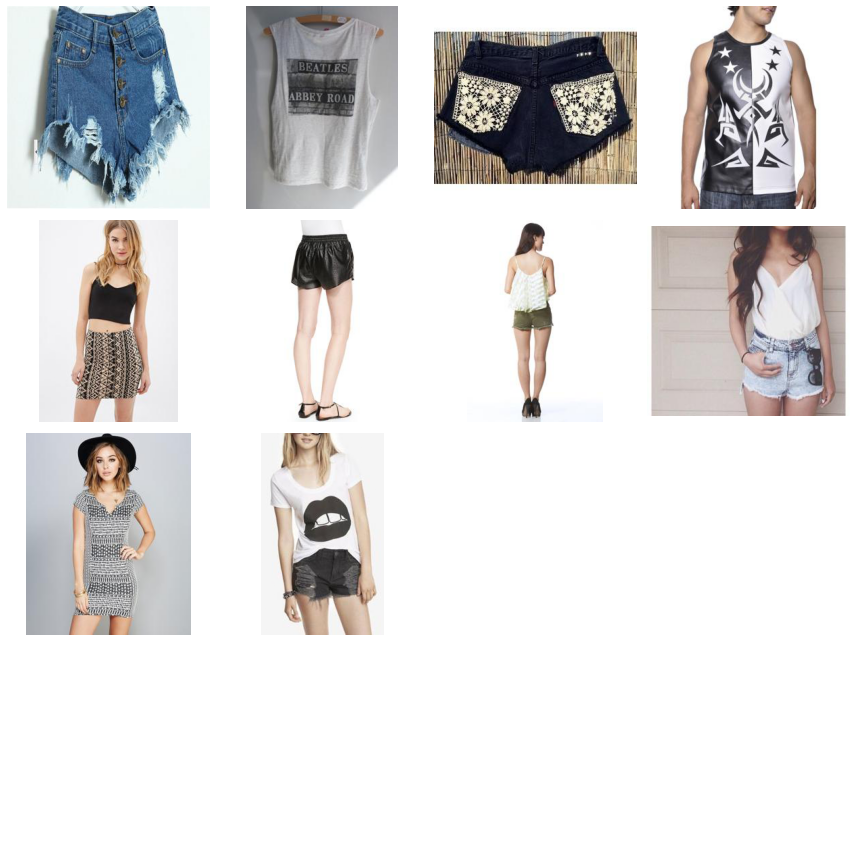

In [64]:
style_weather = data_df_ouput.iloc[hot_grunge_id] 
show_similar_images(style_weather, fig_size=[12,12])

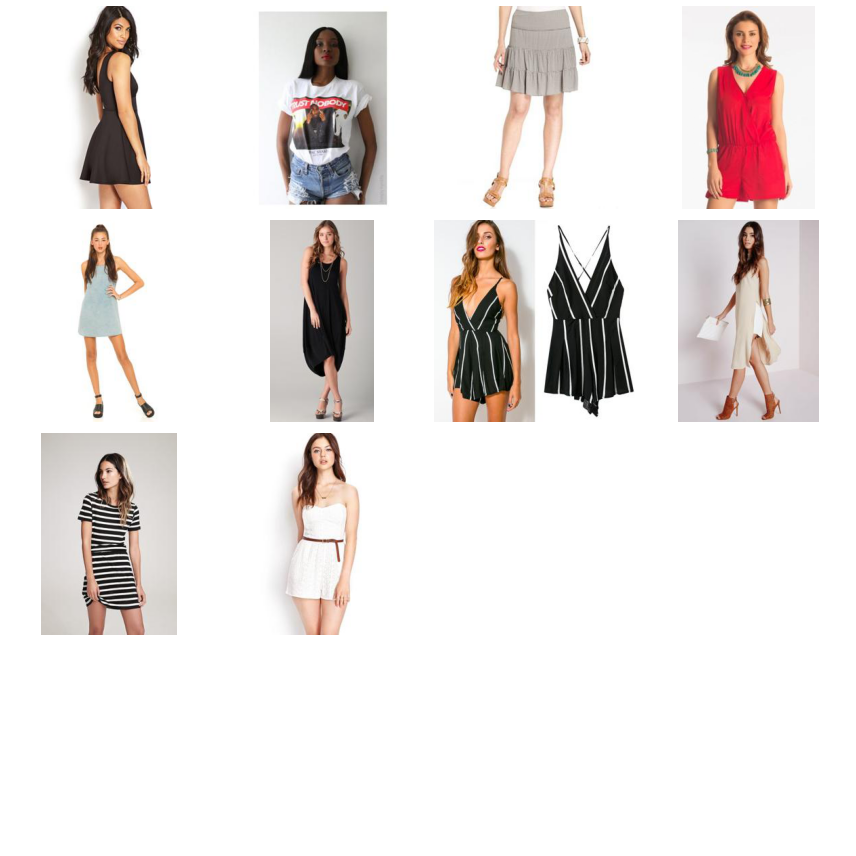

In [65]:
style_weather = data_df_ouput.iloc[hot_classic_id] 
show_similar_images(style_weather, fig_size=[12,12])

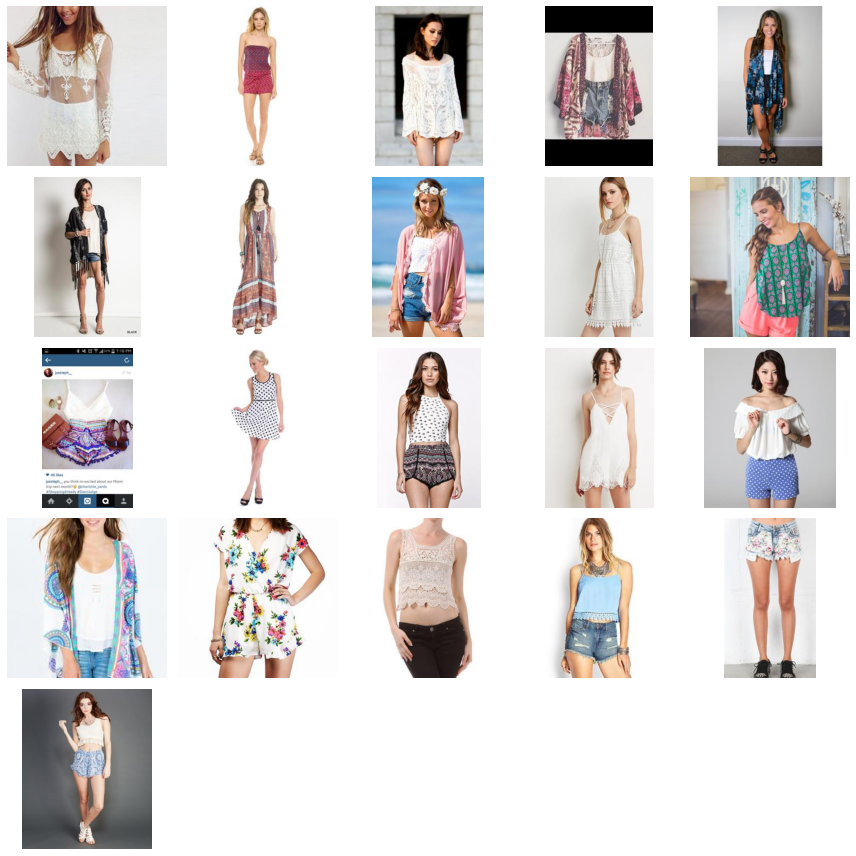

In [66]:
style_weather = data_df_ouput.iloc[hot_bohemian_id] 
show_similar_images(style_weather, fig_size=[12,12])

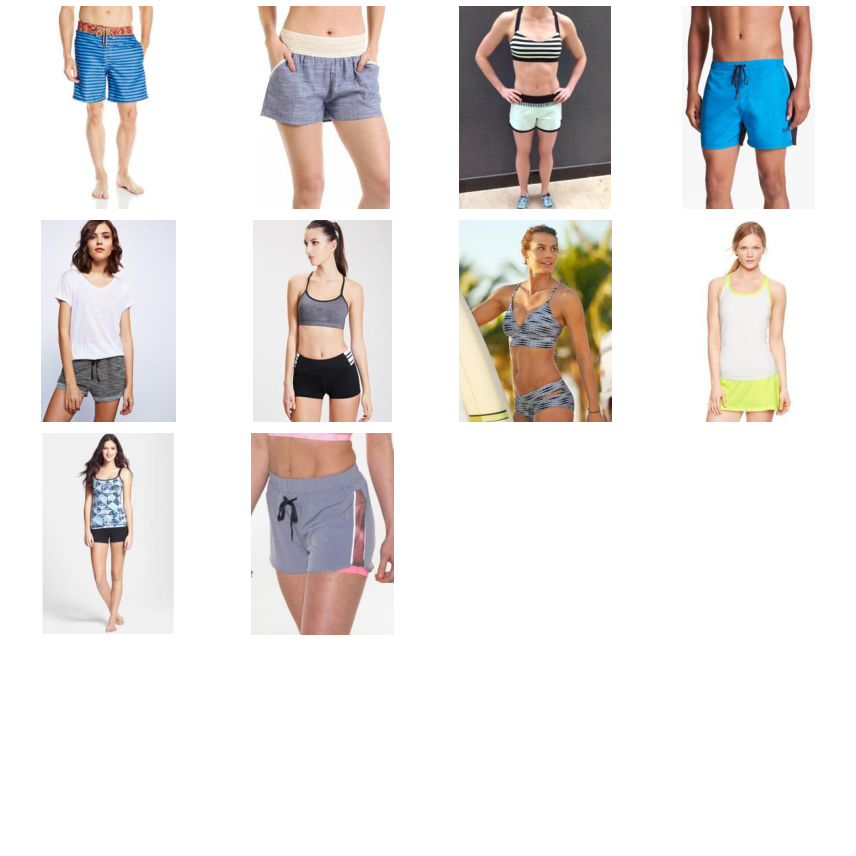

In [67]:
style_weather = data_df_ouput.iloc[hot_athletic_id] 
show_similar_images(style_weather, fig_size=[12,12])

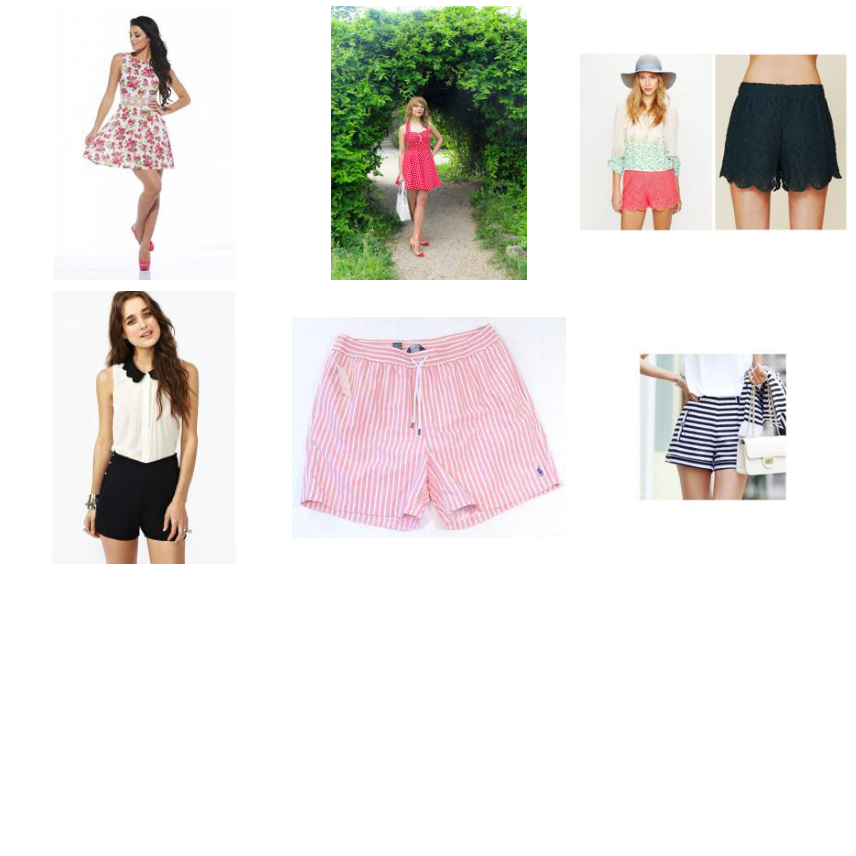

In [68]:
style_weather = data_df_ouput.iloc[hot_preppy_id] 
show_similar_images(style_weather, fig_size=[12,12])

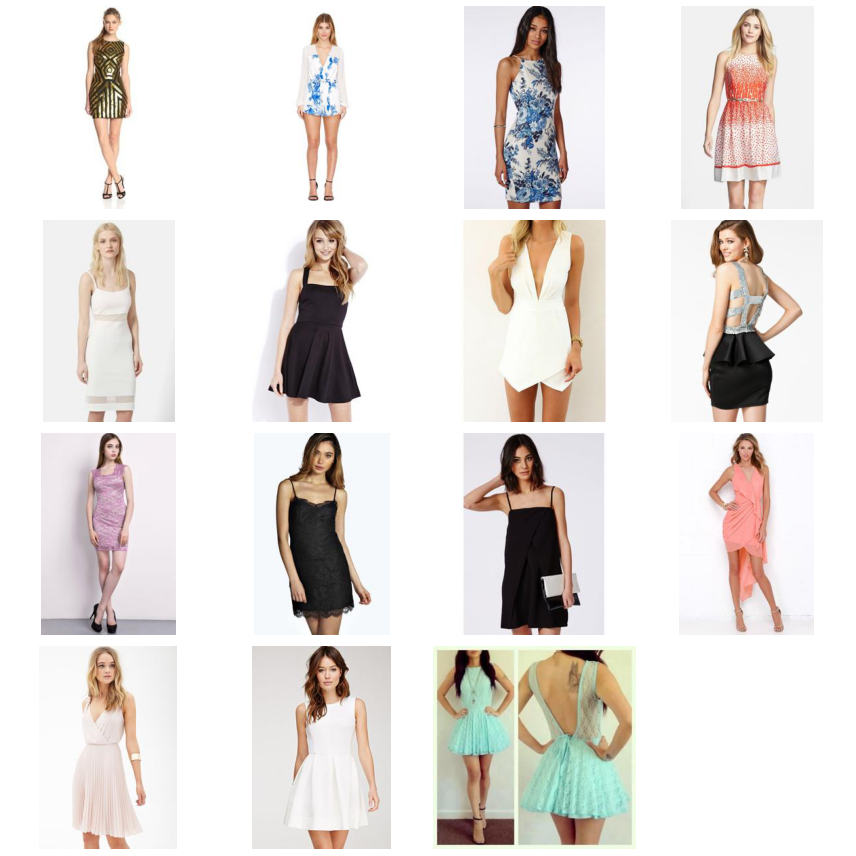

In [69]:
style_weather = data_df_ouput.iloc[hot_formal_id] 
show_similar_images(style_weather, fig_size=[12,12])